In [1]:
!pip install emoji

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 590.6/590.6 kB 11.1 MB/s eta 0:00:00


In [12]:
import pandas as pd
import ast
import emoji
import numpy as np
from tqdm import tqdm
import logging
from sentence_transformers import SentenceTransformer, util
import matplotlib.pyplot as plt
from collections import Counter
from wordcloud import WordCloud
import seaborn as sns

In [13]:
# Setup logging
logging.basicConfig(level=logging.INFO, format='%(asctime)s - %(levelname)s - %(message)s', force=True)

# Load model
logging.info("Loading sentence transformer model...")
model = SentenceTransformer('paraphrase-MiniLM-L6-v2')

# Embedding cache
embedding_cache = {}

2025-05-17 10:12:23,589 - INFO - Loading sentence transformer model...
2025-05-17 10:12:23,610 - INFO - Use pytorch device_name: cpu
2025-05-17 10:12:23,611 - INFO - Load pretrained SentenceTransformer: paraphrase-MiniLM-L6-v2


In [14]:
# Load data
def load_data(file_path, mode="initial"):
    logging.info(f"📥 Loading data from {file_path}...")
    df = pd.read_csv(file_path, on_bad_lines='skip', encoding='utf-8')
    if mode == "initial":
      df['keywords'] = df['keywords'].apply(lambda x: ast.literal_eval(x) if pd.notnull(x) else {})
    else:
      df.rename(columns={'text': 'tweets', 'kws': 'keywords'}, inplace=True)
      df['keywords'] = df['keywords'].apply(lambda x: ast.literal_eval(x) if pd.notnull(x) else [])
    df['id'] = range(0, len(df))
    return df

In [15]:
# Prepare emoji dataset
def prepare_emoji_data():
    logging.info("Preparing emoji descriptions and embeddings...")
    emoji_list = [(emj, emoji.demojize(emj).strip(":").replace("_", " ")) for emj in emoji.EMOJI_DATA.keys()]
    emoji_df = pd.DataFrame(emoji_list, columns=['emoji', 'description'])
    logging.info(f"Total emojis: {len(emoji_df)}")
    logging.info("\n" + str(emoji_df.head(10)))
    emoji_df['embedding'] = list(model.encode(emoji_df['description'].tolist(), batch_size=32, show_progress_bar=True))
    return emoji_df


In [16]:
# Map keyword to top emoji
def find_best_emoji_for_keyword(keyword, emoji_df, threshold=0.3):
    if keyword in embedding_cache:
        keyword_vec = embedding_cache[keyword]
    else:
        keyword_vec = model.encode(keyword)
        embedding_cache[keyword] = keyword_vec

    similarities = [util.cos_sim(keyword_vec, vec)[0][0].item() for vec in emoji_df['embedding']]
    max_sim = max(similarities)
    if max_sim < threshold:
        return ''
    top_index = int(np.argmax(similarities))
    return emoji_df.iloc[top_index]['emoji']

In [17]:
# Map all keywords to emojis
def map_all_keywords_to_emojis(data, emoji_df, mode="initial"):
    results = []
    keyword_emoji_map = []
    logging.info("Mapping keywords to emojis...")
    for _, row in tqdm(data.iterrows(), total=len(data)):
        logging.info(f"Processing ID: {row['id']}")
        if mode == "initial":
          sorted_keywords = sorted(row['keywords'].items(), key=lambda x: -x[1])
        else:
          sorted_keywords = row['keywords']
        emojis = []
        mapping = {}
        if mode == "initial":
          for k, _ in sorted_keywords:
              best_emoji = find_best_emoji_for_keyword(k, emoji_df)
              if best_emoji:
                  emojis.append(best_emoji)
                  mapping[k] = best_emoji
          results.append(' '.join(emojis))
          keyword_emoji_map.append(mapping)
        else:
          for k in sorted_keywords:
              best_emoji = find_best_emoji_for_keyword(k, emoji_df)
              if best_emoji:
                  emojis.append(best_emoji)
                  mapping[k] = best_emoji
          results.append(' '.join(emojis))
          keyword_emoji_map.append(mapping)

    data['keyword_emoji_map'] = keyword_emoji_map
    return results

In [18]:
def visualize_emoji_distribution(data, emoji_df, mode):
    filename=f"emoji_distribution_{mode}.png"
    logging.info("Visualizing emoji usage...")
    all_emojis = ' '.join(data['emojis'].fillna('')).split()
    counts = Counter(all_emojis)
    top_emojis = dict(counts.most_common(15))

    emoji_desc_map = dict(zip(emoji_df['emoji'], emoji_df['description']))
    labels = [
        f"{emoji_desc_map.get(emj, '').split()[0]}"  # just the first word of the description
        for emj in top_emojis.keys()
    ]

    # Plot
    plt.figure(figsize=(12, 6))
    sns.barplot(x=labels, y=list(top_emojis.values()))
    plt.xticks(rotation=45, ha='right')
    plt.title(f"Top 15 Most Frequent Emojis {mode}")
    plt.xlabel("Description")
    plt.ylabel("Frequency")
    plt.tight_layout()
    plt.savefig(filename)
    plt.show()

In [19]:
# Visualize keyword cloud
def visualize_keywords(data, mode):
    filename=f"keyword_cloud_{mode}.png"
    logging.info("Creating keyword WordCloud...")
    keyword_text = ' '.join([' '.join(d.keys()) for d in data['keyword_emoji_map']])
    wordcloud = WordCloud(width=800, height=300, background_color='white').generate(keyword_text)
    plt.figure(figsize=(12, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Keyword WordCloud {mode}")
    plt.savefig(filename)
    plt.show()

In [20]:
# Main
def main(mode="initial"):
    file_path = 'tiny_test.csv' if mode == "initial" else 'predictions.csv'
    data = load_data(file_path, mode=mode)
    emoji_df = prepare_emoji_data()
    data['emojis'] = map_all_keywords_to_emojis(data, emoji_df, mode=mode)

    # Save output
    data[['id', 'tweets', 'emojis']].to_csv(f"tweets_with_emojis_{mode}.csv", index=False)
    emoji_df[['emoji', 'description']].to_csv('emoji_descriptions.csv', index=False)
    logging.info("Output saved to CSV files.")

    # Preview
    display(data[['id', 'tweets', 'emojis']].head())

    # Visualizations
    visualize_emoji_distribution(data, emoji_df, mode=mode)
    visualize_keywords(data, mode=mode)

2025-05-17 10:12:39,449 - INFO - 📥 Loading data from predictions.csv...
2025-05-17 10:12:39,476 - INFO - Preparing emoji descriptions and embeddings...
2025-05-17 10:12:39,503 - INFO - Total emojis: 5042
2025-05-17 10:12:39,506 - INFO - 
  emoji             description
0     🥇         1st place medal
1     🥈         2nd place medal
2     🥉         3rd place medal
3     🆎  AB button (blood type)
4     🏧                ATM sign
5    🅰️   A button (blood type)
6     🅰   A button (blood type)
7    🇦🇫             Afghanistan
8    🇦🇱                 Albania
9    🇩🇿                 Algeria


Batches:   0%|          | 0/158 [00:00<?, ?it/s]

2025-05-17 10:13:05,036 - INFO - Mapping keywords to emojis...
  0%|          | 0/1000 [00:00<?, ?it/s]2025-05-17 10:13:05,040 - INFO - Processing ID: 0


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 1/1000 [00:02<39:14,  2.36s/it]2025-05-17 10:13:07,397 - INFO - Processing ID: 1


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 2/1000 [00:03<27:51,  1.67s/it]2025-05-17 10:13:08,594 - INFO - Processing ID: 2


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 3/1000 [00:05<29:26,  1.77s/it]2025-05-17 10:13:10,482 - INFO - Processing ID: 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 4/1000 [00:07<29:36,  1.78s/it]2025-05-17 10:13:12,285 - INFO - Processing ID: 4


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  0%|          | 5/1000 [00:09<34:59,  2.11s/it]2025-05-17 10:13:14,972 - INFO - Processing ID: 5


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  1%|          | 6/1000 [00:13<44:19,  2.68s/it]2025-05-17 10:13:18,747 - INFO - Processing ID: 6


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  1%|          | 7/1000 [00:15<39:23,  2.38s/it]2025-05-17 10:13:20,519 - INFO - Processing ID: 7


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  1%|          | 8/1000 [00:17<39:24,  2.38s/it]2025-05-17 10:13:22,909 - INFO - Processing ID: 8


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  1%|          | 9/1000 [00:19<36:07,  2.19s/it]2025-05-17 10:13:24,664 - INFO - Processing ID: 9


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  1%|          | 10/1000 [00:21<36:58,  2.24s/it]2025-05-17 10:13:27,025 - INFO - Processing ID: 10


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  1%|          | 11/1000 [00:25<42:37,  2.59s/it]2025-05-17 10:13:30,394 - INFO - Processing ID: 11


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  1%|          | 12/1000 [00:27<38:12,  2.32s/it]2025-05-17 10:13:32,107 - INFO - Processing ID: 12


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  1%|▏         | 13/1000 [00:28<35:57,  2.19s/it]2025-05-17 10:13:33,983 - INFO - Processing ID: 13


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  1%|▏         | 14/1000 [00:31<39:25,  2.40s/it]2025-05-17 10:13:36,876 - INFO - Processing ID: 14


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  2%|▏         | 15/1000 [00:34<41:35,  2.53s/it]2025-05-17 10:13:39,721 - INFO - Processing ID: 15


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  2%|▏         | 16/1000 [00:37<44:59,  2.74s/it]2025-05-17 10:13:42,951 - INFO - Processing ID: 16


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  2%|▏         | 17/1000 [00:40<43:48,  2.67s/it]2025-05-17 10:13:45,464 - INFO - Processing ID: 17


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  2%|▏         | 18/1000 [00:42<42:20,  2.59s/it]2025-05-17 10:13:47,848 - INFO - Processing ID: 18


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  2%|▏         | 19/1000 [00:45<40:51,  2.50s/it]2025-05-17 10:13:50,143 - INFO - Processing ID: 19


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  2%|▏         | 20/1000 [00:46<33:55,  2.08s/it]2025-05-17 10:13:51,235 - INFO - Processing ID: 20


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  2%|▏         | 21/1000 [00:47<32:27,  1.99s/it]2025-05-17 10:13:53,019 - INFO - Processing ID: 21


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  2%|▏         | 22/1000 [00:51<39:34,  2.43s/it]2025-05-17 10:13:56,472 - INFO - Processing ID: 22


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  2%|▏         | 23/1000 [00:53<39:15,  2.41s/it]2025-05-17 10:13:58,841 - INFO - Processing ID: 23


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  2%|▏         | 24/1000 [00:56<38:39,  2.38s/it]2025-05-17 10:14:01,139 - INFO - Processing ID: 24


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  3%|▎         | 26/1000 [00:58<27:44,  1.71s/it]2025-05-17 10:14:03,506 - INFO - Processing ID: 26


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  3%|▎         | 27/1000 [01:00<30:36,  1.89s/it]2025-05-17 10:14:05,811 - INFO - Processing ID: 27


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  3%|▎         | 28/1000 [01:01<24:42,  1.53s/it]2025-05-17 10:14:06,491 - INFO - Processing ID: 28


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  3%|▎         | 29/1000 [01:04<33:49,  2.09s/it]2025-05-17 10:14:09,898 - INFO - Processing ID: 29


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  3%|▎         | 30/1000 [01:07<35:14,  2.18s/it]2025-05-17 10:14:12,288 - INFO - Processing ID: 30


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  3%|▎         | 31/1000 [01:09<36:28,  2.26s/it]2025-05-17 10:14:14,728 - INFO - Processing ID: 31


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  3%|▎         | 32/1000 [01:12<37:08,  2.30s/it]2025-05-17 10:14:17,132 - INFO - Processing ID: 32


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  3%|▎         | 33/1000 [01:13<35:09,  2.18s/it]2025-05-17 10:14:19,034 - INFO - Processing ID: 33


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  3%|▎         | 34/1000 [01:17<40:34,  2.52s/it]2025-05-17 10:14:22,350 - INFO - Processing ID: 34


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  4%|▎         | 35/1000 [01:19<41:10,  2.56s/it]2025-05-17 10:14:24,996 - INFO - Processing ID: 35


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  4%|▎         | 36/1000 [01:21<37:46,  2.35s/it]2025-05-17 10:14:26,861 - INFO - Processing ID: 36


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  4%|▎         | 37/1000 [01:23<32:11,  2.01s/it]2025-05-17 10:14:28,060 - INFO - Processing ID: 37


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  4%|▍         | 38/1000 [01:24<28:33,  1.78s/it]2025-05-17 10:14:29,318 - INFO - Processing ID: 38


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  4%|▍         | 39/1000 [01:26<32:12,  2.01s/it]2025-05-17 10:14:31,864 - INFO - Processing ID: 39


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  4%|▍         | 40/1000 [01:30<41:59,  2.62s/it]2025-05-17 10:14:35,919 - INFO - Processing ID: 40


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  4%|▍         | 41/1000 [01:32<37:37,  2.35s/it]2025-05-17 10:14:37,643 - INFO - Processing ID: 41


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  4%|▍         | 42/1000 [01:35<38:12,  2.39s/it]2025-05-17 10:14:40,126 - INFO - Processing ID: 42


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  4%|▍         | 43/1000 [01:35<29:40,  1.86s/it]2025-05-17 10:14:40,746 - INFO - Processing ID: 43


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  4%|▍         | 44/1000 [01:37<29:38,  1.86s/it]2025-05-17 10:14:42,605 - INFO - Processing ID: 44


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  4%|▍         | 45/1000 [01:40<32:57,  2.07s/it]2025-05-17 10:14:45,166 - INFO - Processing ID: 45


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  5%|▍         | 46/1000 [01:41<30:49,  1.94s/it]2025-05-17 10:14:46,797 - INFO - Processing ID: 46


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  5%|▍         | 47/1000 [01:45<37:18,  2.35s/it]2025-05-17 10:14:50,103 - INFO - Processing ID: 47


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  5%|▍         | 48/1000 [01:46<31:27,  1.98s/it]2025-05-17 10:14:51,230 - INFO - Processing ID: 48


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  5%|▍         | 49/1000 [01:48<30:51,  1.95s/it]2025-05-17 10:14:53,096 - INFO - Processing ID: 49


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  5%|▌         | 50/1000 [01:50<33:21,  2.11s/it]2025-05-17 10:14:55,575 - INFO - Processing ID: 50


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  5%|▌         | 51/1000 [01:53<35:20,  2.23s/it]2025-05-17 10:14:58,108 - INFO - Processing ID: 51


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  5%|▌         | 52/1000 [01:55<38:28,  2.44s/it]2025-05-17 10:15:01,012 - INFO - Processing ID: 52


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  5%|▌         | 53/1000 [01:56<31:28,  1.99s/it]2025-05-17 10:15:01,976 - INFO - Processing ID: 53
2025-05-17 10:15:01,979 - INFO - Processing ID: 54


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|▌         | 55/1000 [01:59<24:40,  1.57s/it]2025-05-17 10:15:04,111 - INFO - Processing ID: 55


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|▌         | 56/1000 [02:01<27:36,  1.75s/it]2025-05-17 10:15:06,437 - INFO - Processing ID: 56


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|▌         | 57/1000 [02:03<30:32,  1.94s/it]2025-05-17 10:15:08,912 - INFO - Processing ID: 57


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|▌         | 58/1000 [02:05<30:26,  1.94s/it]2025-05-17 10:15:10,841 - INFO - Processing ID: 58


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|▌         | 59/1000 [02:08<34:30,  2.20s/it]2025-05-17 10:15:13,713 - INFO - Processing ID: 59


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|▌         | 60/1000 [02:11<38:34,  2.46s/it]2025-05-17 10:15:16,829 - INFO - Processing ID: 60


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|▌         | 61/1000 [02:13<36:06,  2.31s/it]2025-05-17 10:15:18,756 - INFO - Processing ID: 61


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|▌         | 62/1000 [02:16<36:56,  2.36s/it]2025-05-17 10:15:21,255 - INFO - Processing ID: 62


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|▋         | 63/1000 [02:18<36:52,  2.36s/it]2025-05-17 10:15:23,612 - INFO - Processing ID: 63


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|▋         | 64/1000 [02:21<37:42,  2.42s/it]2025-05-17 10:15:26,167 - INFO - Processing ID: 64


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  6%|▋         | 65/1000 [02:24<41:23,  2.66s/it]2025-05-17 10:15:29,383 - INFO - Processing ID: 65


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  7%|▋         | 66/1000 [02:26<40:43,  2.62s/it]2025-05-17 10:15:31,906 - INFO - Processing ID: 66


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  7%|▋         | 67/1000 [02:28<37:08,  2.39s/it]2025-05-17 10:15:33,761 - INFO - Processing ID: 67


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  7%|▋         | 68/1000 [02:31<37:03,  2.39s/it]2025-05-17 10:15:36,139 - INFO - Processing ID: 68


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  7%|▋         | 69/1000 [02:33<37:58,  2.45s/it]2025-05-17 10:15:38,729 - INFO - Processing ID: 69


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  7%|▋         | 70/1000 [02:37<42:47,  2.76s/it]2025-05-17 10:15:42,223 - INFO - Processing ID: 70


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  7%|▋         | 71/1000 [02:38<35:14,  2.28s/it]2025-05-17 10:15:43,366 - INFO - Processing ID: 71


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  7%|▋         | 72/1000 [02:40<33:10,  2.14s/it]2025-05-17 10:15:45,204 - INFO - Processing ID: 72


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  7%|▋         | 73/1000 [02:41<28:59,  1.88s/it]2025-05-17 10:15:46,455 - INFO - Processing ID: 73


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  7%|▋         | 74/1000 [02:43<31:03,  2.01s/it]2025-05-17 10:15:48,784 - INFO - Processing ID: 74


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  8%|▊         | 75/1000 [02:46<33:20,  2.16s/it]2025-05-17 10:15:51,298 - INFO - Processing ID: 75


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  8%|▊         | 76/1000 [02:46<26:11,  1.70s/it]2025-05-17 10:15:51,920 - INFO - Processing ID: 76


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  8%|▊         | 77/1000 [02:50<35:27,  2.30s/it]2025-05-17 10:15:55,633 - INFO - Processing ID: 77


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  8%|▊         | 78/1000 [02:52<33:46,  2.20s/it]2025-05-17 10:15:57,584 - INFO - Processing ID: 78


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  8%|▊         | 79/1000 [02:54<31:23,  2.05s/it]2025-05-17 10:15:59,273 - INFO - Processing ID: 79


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  8%|▊         | 80/1000 [02:56<30:38,  2.00s/it]2025-05-17 10:16:01,160 - INFO - Processing ID: 80


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  8%|▊         | 81/1000 [02:57<27:16,  1.78s/it]2025-05-17 10:16:02,435 - INFO - Processing ID: 81


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  8%|▊         | 82/1000 [02:59<30:12,  1.97s/it]2025-05-17 10:16:04,860 - INFO - Processing ID: 82


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  8%|▊         | 83/1000 [03:02<31:39,  2.07s/it]2025-05-17 10:16:07,158 - INFO - Processing ID: 83


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  8%|▊         | 85/1000 [03:05<27:36,  1.81s/it]2025-05-17 10:16:10,700 - INFO - Processing ID: 85


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  9%|▊         | 86/1000 [03:08<30:19,  1.99s/it]2025-05-17 10:16:13,112 - INFO - Processing ID: 86


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  9%|▊         | 87/1000 [03:08<24:13,  1.59s/it]2025-05-17 10:16:13,773 - INFO - Processing ID: 87


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  9%|▉         | 88/1000 [03:11<28:54,  1.90s/it]2025-05-17 10:16:16,399 - INFO - Processing ID: 88


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  9%|▉         | 89/1000 [03:13<30:55,  2.04s/it]2025-05-17 10:16:18,751 - INFO - Processing ID: 89


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  9%|▉         | 90/1000 [03:17<37:27,  2.47s/it]2025-05-17 10:16:22,230 - INFO - Processing ID: 90


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  9%|▉         | 91/1000 [03:19<37:12,  2.46s/it]2025-05-17 10:16:24,655 - INFO - Processing ID: 91


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  9%|▉         | 92/1000 [03:21<34:54,  2.31s/it]2025-05-17 10:16:26,612 - INFO - Processing ID: 92


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

  9%|▉         | 93/1000 [03:24<35:30,  2.35s/it]2025-05-17 10:16:29,060 - INFO - Processing ID: 93


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 10%|▉         | 95/1000 [03:25<21:55,  1.45s/it]2025-05-17 10:16:30,271 - INFO - Processing ID: 95


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 10%|▉         | 96/1000 [03:27<24:09,  1.60s/it]2025-05-17 10:16:32,227 - INFO - Processing ID: 96


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 10%|▉         | 97/1000 [03:28<24:25,  1.62s/it]2025-05-17 10:16:33,892 - INFO - Processing ID: 97


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 10%|▉         | 98/1000 [03:31<29:50,  1.98s/it]2025-05-17 10:16:36,721 - INFO - Processing ID: 98


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 10%|▉         | 99/1000 [03:32<26:12,  1.74s/it]2025-05-17 10:16:37,912 - INFO - Processing ID: 99


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 10%|█         | 100/1000 [03:35<30:03,  2.00s/it]2025-05-17 10:16:40,515 - INFO - Processing ID: 100


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 10%|█         | 101/1000 [03:37<30:56,  2.07s/it]2025-05-17 10:16:42,722 - INFO - Processing ID: 101


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 10%|█         | 102/1000 [03:39<30:18,  2.03s/it]2025-05-17 10:16:44,654 - INFO - Processing ID: 102


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 10%|█         | 103/1000 [03:42<35:17,  2.36s/it]2025-05-17 10:16:47,799 - INFO - Processing ID: 103


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 10%|█         | 104/1000 [03:45<36:40,  2.46s/it]2025-05-17 10:16:50,477 - INFO - Processing ID: 104


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 10%|█         | 105/1000 [03:46<31:21,  2.10s/it]2025-05-17 10:16:51,753 - INFO - Processing ID: 105


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 11%|█         | 106/1000 [03:49<32:47,  2.20s/it]2025-05-17 10:16:54,185 - INFO - Processing ID: 106


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 11%|█         | 107/1000 [03:51<33:04,  2.22s/it]2025-05-17 10:16:56,456 - INFO - Processing ID: 107


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 11%|█         | 108/1000 [03:53<34:25,  2.32s/it]2025-05-17 10:16:58,992 - INFO - Processing ID: 108


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 11%|█         | 109/1000 [03:57<38:34,  2.60s/it]2025-05-17 10:17:02,244 - INFO - Processing ID: 109


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 11%|█         | 110/1000 [03:57<29:58,  2.02s/it]2025-05-17 10:17:02,919 - INFO - Processing ID: 110


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 11%|█         | 111/1000 [04:00<31:27,  2.12s/it]2025-05-17 10:17:05,282 - INFO - Processing ID: 111


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 11%|█         | 112/1000 [04:02<30:41,  2.07s/it]2025-05-17 10:17:07,240 - INFO - Processing ID: 112


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 11%|█▏        | 113/1000 [04:03<27:11,  1.84s/it]2025-05-17 10:17:08,534 - INFO - Processing ID: 113


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 11%|█▏        | 114/1000 [04:04<25:06,  1.70s/it]2025-05-17 10:17:09,911 - INFO - Processing ID: 114


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 12%|█▏        | 115/1000 [04:07<31:07,  2.11s/it]2025-05-17 10:17:12,977 - INFO - Processing ID: 115


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 12%|█▏        | 116/1000 [04:10<33:05,  2.25s/it]2025-05-17 10:17:15,540 - INFO - Processing ID: 116


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 12%|█▏        | 117/1000 [04:13<34:32,  2.35s/it]2025-05-17 10:17:18,121 - INFO - Processing ID: 117


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 12%|█▏        | 118/1000 [04:15<35:07,  2.39s/it]2025-05-17 10:17:20,610 - INFO - Processing ID: 118


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 12%|█▏        | 119/1000 [04:18<35:42,  2.43s/it]2025-05-17 10:17:23,140 - INFO - Processing ID: 119


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 12%|█▏        | 120/1000 [04:20<37:06,  2.53s/it]2025-05-17 10:17:25,899 - INFO - Processing ID: 120


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 12%|█▏        | 121/1000 [04:24<40:19,  2.75s/it]2025-05-17 10:17:29,172 - INFO - Processing ID: 121


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 12%|█▏        | 122/1000 [04:25<35:47,  2.45s/it]2025-05-17 10:17:30,900 - INFO - Processing ID: 122


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 12%|█▏        | 123/1000 [04:27<30:49,  2.11s/it]2025-05-17 10:17:32,222 - INFO - Processing ID: 123


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 12%|█▏        | 124/1000 [04:29<31:38,  2.17s/it]2025-05-17 10:17:34,527 - INFO - Processing ID: 124


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 13%|█▎        | 126/1000 [04:32<24:55,  1.71s/it]2025-05-17 10:17:37,377 - INFO - Processing ID: 126


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 13%|█▎        | 127/1000 [04:32<20:15,  1.39s/it]2025-05-17 10:17:38,025 - INFO - Processing ID: 127


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 13%|█▎        | 128/1000 [04:34<21:59,  1.51s/it]2025-05-17 10:17:39,822 - INFO - Processing ID: 128


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 13%|█▎        | 129/1000 [04:37<26:34,  1.83s/it]2025-05-17 10:17:42,393 - INFO - Processing ID: 129


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 13%|█▎        | 130/1000 [04:39<29:34,  2.04s/it]2025-05-17 10:17:44,922 - INFO - Processing ID: 130


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 13%|█▎        | 131/1000 [04:40<23:26,  1.62s/it]2025-05-17 10:17:45,558 - INFO - Processing ID: 131


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 13%|█▎        | 132/1000 [04:42<27:00,  1.87s/it]2025-05-17 10:17:48,003 - INFO - Processing ID: 132


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 13%|█▎        | 133/1000 [04:44<23:56,  1.66s/it]2025-05-17 10:17:49,171 - INFO - Processing ID: 133


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 13%|█▎        | 134/1000 [04:45<22:19,  1.55s/it]2025-05-17 10:17:50,462 - INFO - Processing ID: 134


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 14%|█▎        | 135/1000 [04:48<28:27,  1.97s/it]2025-05-17 10:17:53,435 - INFO - Processing ID: 135


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 14%|█▎        | 136/1000 [04:50<27:41,  1.92s/it]2025-05-17 10:17:55,236 - INFO - Processing ID: 136


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 14%|█▎        | 137/1000 [04:52<29:38,  2.06s/it]2025-05-17 10:17:57,616 - INFO - Processing ID: 137


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 14%|█▍        | 138/1000 [04:55<31:24,  2.19s/it]2025-05-17 10:18:00,095 - INFO - Processing ID: 138


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 14%|█▍        | 139/1000 [04:56<27:34,  1.92s/it]2025-05-17 10:18:01,400 - INFO - Processing ID: 139


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 14%|█▍        | 140/1000 [04:58<26:54,  1.88s/it]2025-05-17 10:18:03,173 - INFO - Processing ID: 140


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 14%|█▍        | 142/1000 [05:02<28:23,  1.99s/it]2025-05-17 10:18:07,565 - INFO - Processing ID: 142


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 14%|█▍        | 143/1000 [05:05<31:20,  2.19s/it]2025-05-17 10:18:10,244 - INFO - Processing ID: 143


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 14%|█▍        | 144/1000 [05:07<31:46,  2.23s/it]2025-05-17 10:18:12,549 - INFO - Processing ID: 144


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 14%|█▍        | 145/1000 [05:10<33:19,  2.34s/it]2025-05-17 10:18:15,148 - INFO - Processing ID: 145


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 15%|█▍        | 146/1000 [05:11<28:28,  2.00s/it]2025-05-17 10:18:16,360 - INFO - Processing ID: 146


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 15%|█▍        | 148/1000 [05:15<28:50,  2.03s/it]2025-05-17 10:18:20,723 - INFO - Processing ID: 148


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 15%|█▍        | 149/1000 [05:18<31:46,  2.24s/it]2025-05-17 10:18:23,451 - INFO - Processing ID: 149


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 15%|█▌        | 150/1000 [05:19<25:02,  1.77s/it]2025-05-17 10:18:24,117 - INFO - Processing ID: 150


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 15%|█▌        | 151/1000 [05:21<27:18,  1.93s/it]2025-05-17 10:18:26,425 - INFO - Processing ID: 151


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 15%|█▌        | 152/1000 [05:23<27:22,  1.94s/it]2025-05-17 10:18:28,378 - INFO - Processing ID: 152


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 15%|█▌        | 153/1000 [05:25<29:49,  2.11s/it]2025-05-17 10:18:30,902 - INFO - Processing ID: 153


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 15%|█▌        | 154/1000 [05:29<34:16,  2.43s/it]2025-05-17 10:18:34,081 - INFO - Processing ID: 154


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 16%|█▌        | 155/1000 [05:31<33:21,  2.37s/it]2025-05-17 10:18:36,297 - INFO - Processing ID: 155


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 16%|█▌        | 156/1000 [05:33<31:17,  2.22s/it]2025-05-17 10:18:38,185 - INFO - Processing ID: 156


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 16%|█▌        | 157/1000 [05:35<30:20,  2.16s/it]2025-05-17 10:18:40,194 - INFO - Processing ID: 157


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 16%|█▌        | 158/1000 [05:37<31:16,  2.23s/it]2025-05-17 10:18:42,585 - INFO - Processing ID: 158


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 16%|█▌        | 160/1000 [05:41<29:39,  2.12s/it]2025-05-17 10:18:46,771 - INFO - Processing ID: 160


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 16%|█▌        | 161/1000 [05:44<30:49,  2.20s/it]2025-05-17 10:18:49,176 - INFO - Processing ID: 161


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 16%|█▋        | 163/1000 [05:47<27:00,  1.94s/it]2025-05-17 10:18:52,798 - INFO - Processing ID: 163


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 16%|█▋        | 164/1000 [05:50<29:17,  2.10s/it]2025-05-17 10:18:55,286 - INFO - Processing ID: 164


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 16%|█▋        | 165/1000 [05:52<31:44,  2.28s/it]2025-05-17 10:18:57,990 - INFO - Processing ID: 165


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 17%|█▋        | 166/1000 [05:56<35:55,  2.58s/it]2025-05-17 10:19:01,279 - INFO - Processing ID: 166


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 17%|█▋        | 167/1000 [05:58<36:26,  2.63s/it]2025-05-17 10:19:03,998 - INFO - Processing ID: 167


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 17%|█▋        | 168/1000 [06:01<34:40,  2.50s/it]2025-05-17 10:19:06,207 - INFO - Processing ID: 168


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 17%|█▋        | 169/1000 [06:03<34:42,  2.51s/it]2025-05-17 10:19:08,728 - INFO - Processing ID: 169


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 17%|█▋        | 170/1000 [06:06<36:33,  2.64s/it]2025-05-17 10:19:11,694 - INFO - Processing ID: 170


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 17%|█▋        | 171/1000 [06:09<37:57,  2.75s/it]2025-05-17 10:19:14,681 - INFO - Processing ID: 171


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 17%|█▋        | 172/1000 [06:12<36:39,  2.66s/it]2025-05-17 10:19:17,125 - INFO - Processing ID: 172


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 17%|█▋        | 173/1000 [06:14<36:38,  2.66s/it]2025-05-17 10:19:19,786 - INFO - Processing ID: 173


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 17%|█▋        | 174/1000 [06:16<33:04,  2.40s/it]2025-05-17 10:19:21,594 - INFO - Processing ID: 174


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 18%|█▊        | 175/1000 [06:17<28:05,  2.04s/it]2025-05-17 10:19:22,799 - INFO - Processing ID: 175


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 18%|█▊        | 176/1000 [06:21<33:26,  2.43s/it]2025-05-17 10:19:26,147 - INFO - Processing ID: 176


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 18%|█▊        | 177/1000 [06:22<30:13,  2.20s/it]2025-05-17 10:19:27,810 - INFO - Processing ID: 177
2025-05-17 10:19:27,812 - INFO - Processing ID: 178
 18%|█▊        | 179/1000 [06:23<17:58,  1.31s/it]2025-05-17 10:19:28,359 - INFO - Processing ID: 179


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 18%|█▊        | 180/1000 [06:25<21:57,  1.61s/it]2025-05-17 10:19:30,855 - INFO - Processing ID: 180


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 18%|█▊        | 181/1000 [06:27<20:27,  1.50s/it]2025-05-17 10:19:32,050 - INFO - Processing ID: 181


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 18%|█▊        | 182/1000 [06:29<24:11,  1.77s/it]2025-05-17 10:19:34,563 - INFO - Processing ID: 182


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 18%|█▊        | 183/1000 [06:31<26:34,  1.95s/it]2025-05-17 10:19:36,968 - INFO - Processing ID: 183


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 18%|█▊        | 185/1000 [06:36<25:42,  1.89s/it]2025-05-17 10:19:41,189 - INFO - Processing ID: 185


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 19%|█▊        | 186/1000 [06:37<25:29,  1.88s/it]2025-05-17 10:19:43,035 - INFO - Processing ID: 186


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 19%|█▊        | 187/1000 [06:40<26:47,  1.98s/it]2025-05-17 10:19:45,246 - INFO - Processing ID: 187


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 19%|█▉        | 188/1000 [06:40<21:33,  1.59s/it]2025-05-17 10:19:45,929 - INFO - Processing ID: 188


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 19%|█▉        | 189/1000 [06:42<22:28,  1.66s/it]2025-05-17 10:19:47,756 - INFO - Processing ID: 189


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 19%|█▉        | 190/1000 [06:43<18:37,  1.38s/it]2025-05-17 10:19:48,471 - INFO - Processing ID: 190


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 19%|█▉        | 191/1000 [06:45<23:08,  1.72s/it]2025-05-17 10:19:50,975 - INFO - Processing ID: 191


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 19%|█▉        | 192/1000 [06:49<30:10,  2.24s/it]2025-05-17 10:19:54,446 - INFO - Processing ID: 192


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 19%|█▉        | 193/1000 [06:50<26:35,  1.98s/it]2025-05-17 10:19:55,806 - INFO - Processing ID: 193


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 19%|█▉        | 194/1000 [06:51<21:23,  1.59s/it]2025-05-17 10:19:56,498 - INFO - Processing ID: 194


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 20%|█▉        | 195/1000 [06:53<24:52,  1.85s/it]2025-05-17 10:19:58,962 - INFO - Processing ID: 195


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 20%|█▉        | 196/1000 [06:55<22:49,  1.70s/it]2025-05-17 10:20:00,316 - INFO - Processing ID: 196


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 20%|█▉        | 198/1000 [06:59<24:44,  1.85s/it]2025-05-17 10:20:04,353 - INFO - Processing ID: 198


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 20%|█▉        | 199/1000 [07:02<29:50,  2.24s/it]2025-05-17 10:20:07,480 - INFO - Processing ID: 199


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 20%|██        | 201/1000 [07:06<27:55,  2.10s/it]2025-05-17 10:20:11,541 - INFO - Processing ID: 201


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 20%|██        | 202/1000 [07:08<29:03,  2.18s/it]2025-05-17 10:20:13,930 - INFO - Processing ID: 202


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 20%|██        | 203/1000 [07:10<28:18,  2.13s/it]2025-05-17 10:20:15,936 - INFO - Processing ID: 203


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 20%|██        | 204/1000 [07:14<32:18,  2.44s/it]2025-05-17 10:20:19,087 - INFO - Processing ID: 204


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 20%|██        | 205/1000 [07:16<32:13,  2.43s/it]2025-05-17 10:20:21,504 - INFO - Processing ID: 205


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 21%|██        | 206/1000 [07:17<25:12,  1.90s/it]2025-05-17 10:20:22,180 - INFO - Processing ID: 206


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 21%|██        | 207/1000 [07:19<27:49,  2.11s/it]2025-05-17 10:20:24,752 - INFO - Processing ID: 207


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 21%|██        | 208/1000 [07:22<29:04,  2.20s/it]2025-05-17 10:20:27,186 - INFO - Processing ID: 208


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 21%|██        | 209/1000 [07:24<29:26,  2.23s/it]2025-05-17 10:20:29,485 - INFO - Processing ID: 209
2025-05-17 10:20:29,487 - INFO - Processing ID: 210


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 21%|██        | 212/1000 [07:28<23:18,  1.77s/it]2025-05-17 10:20:33,460 - INFO - Processing ID: 212


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 21%|██▏       | 213/1000 [07:30<26:02,  1.98s/it]2025-05-17 10:20:36,039 - INFO - Processing ID: 213


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 21%|██▏       | 214/1000 [07:32<25:24,  1.94s/it]2025-05-17 10:20:37,859 - INFO - Processing ID: 214


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 22%|██▏       | 215/1000 [07:35<28:25,  2.17s/it]2025-05-17 10:20:40,631 - INFO - Processing ID: 215


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 22%|██▏       | 216/1000 [07:37<25:45,  1.97s/it]2025-05-17 10:20:42,098 - INFO - Processing ID: 216


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 22%|██▏       | 218/1000 [07:42<30:41,  2.35s/it]2025-05-17 10:20:47,488 - INFO - Processing ID: 218


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 22%|██▏       | 219/1000 [07:43<27:10,  2.09s/it]2025-05-17 10:20:48,940 - INFO - Processing ID: 219


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 22%|██▏       | 220/1000 [07:46<28:42,  2.21s/it]2025-05-17 10:20:51,432 - INFO - Processing ID: 220


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 22%|██▏       | 221/1000 [07:48<27:48,  2.14s/it]2025-05-17 10:20:53,418 - INFO - Processing ID: 221


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 22%|██▏       | 222/1000 [07:50<28:54,  2.23s/it]2025-05-17 10:20:55,854 - INFO - Processing ID: 222


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 22%|██▏       | 223/1000 [07:53<32:04,  2.48s/it]2025-05-17 10:20:58,910 - INFO - Processing ID: 223


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 22%|██▏       | 224/1000 [07:55<30:33,  2.36s/it]2025-05-17 10:21:01,009 - INFO - Processing ID: 224


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 22%|██▎       | 225/1000 [07:58<29:19,  2.27s/it]2025-05-17 10:21:03,059 - INFO - Processing ID: 225


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 23%|██▎       | 226/1000 [08:00<30:38,  2.38s/it]2025-05-17 10:21:05,679 - INFO - Processing ID: 226


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 23%|██▎       | 227/1000 [08:03<30:49,  2.39s/it]2025-05-17 10:21:08,112 - INFO - Processing ID: 227


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 23%|██▎       | 228/1000 [08:06<33:58,  2.64s/it]2025-05-17 10:21:11,337 - INFO - Processing ID: 228


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 23%|██▎       | 229/1000 [08:08<33:16,  2.59s/it]2025-05-17 10:21:13,805 - INFO - Processing ID: 229


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 23%|██▎       | 230/1000 [08:11<32:53,  2.56s/it]2025-05-17 10:21:16,305 - INFO - Processing ID: 230


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 23%|██▎       | 231/1000 [08:12<27:41,  2.16s/it]2025-05-17 10:21:17,525 - INFO - Processing ID: 231


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 23%|██▎       | 232/1000 [08:15<29:20,  2.29s/it]2025-05-17 10:21:20,127 - INFO - Processing ID: 232


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 23%|██▎       | 233/1000 [08:17<30:35,  2.39s/it]2025-05-17 10:21:22,756 - INFO - Processing ID: 233


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 23%|██▎       | 234/1000 [08:21<34:08,  2.67s/it]2025-05-17 10:21:26,086 - INFO - Processing ID: 234


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 24%|██▎       | 235/1000 [08:23<33:00,  2.59s/it]2025-05-17 10:21:28,476 - INFO - Processing ID: 235


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 24%|██▎       | 237/1000 [08:26<27:43,  2.18s/it]2025-05-17 10:21:31,921 - INFO - Processing ID: 237


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 24%|██▍       | 238/1000 [08:28<26:35,  2.09s/it]2025-05-17 10:21:33,815 - INFO - Processing ID: 238


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 24%|██▍       | 239/1000 [08:29<23:11,  1.83s/it]2025-05-17 10:21:35,023 - INFO - Processing ID: 239


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 24%|██▍       | 240/1000 [08:32<24:53,  1.97s/it]2025-05-17 10:21:37,308 - INFO - Processing ID: 240


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 24%|██▍       | 241/1000 [08:34<27:13,  2.15s/it]2025-05-17 10:21:39,896 - INFO - Processing ID: 241


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 24%|██▍       | 242/1000 [08:37<28:20,  2.24s/it]2025-05-17 10:21:42,353 - INFO - Processing ID: 242


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 24%|██▍       | 243/1000 [08:37<22:24,  1.78s/it]2025-05-17 10:21:43,039 - INFO - Processing ID: 243


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 24%|██▍       | 245/1000 [08:41<20:11,  1.60s/it]2025-05-17 10:21:46,291 - INFO - Processing ID: 245


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 25%|██▍       | 246/1000 [08:43<24:25,  1.94s/it]2025-05-17 10:21:49,025 - INFO - Processing ID: 246


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 25%|██▍       | 247/1000 [08:47<30:54,  2.46s/it]2025-05-17 10:21:52,699 - INFO - Processing ID: 247
2025-05-17 10:21:52,702 - INFO - Processing ID: 248


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 25%|██▍       | 249/1000 [08:50<24:28,  1.96s/it]2025-05-17 10:21:55,427 - INFO - Processing ID: 249


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 25%|██▌       | 250/1000 [08:52<25:57,  2.08s/it]2025-05-17 10:21:57,870 - INFO - Processing ID: 250


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 25%|██▌       | 251/1000 [08:55<26:28,  2.12s/it]2025-05-17 10:22:00,117 - INFO - Processing ID: 251


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 25%|██▌       | 252/1000 [08:57<27:29,  2.21s/it]2025-05-17 10:22:02,547 - INFO - Processing ID: 252


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 25%|██▌       | 253/1000 [09:00<31:21,  2.52s/it]2025-05-17 10:22:05,871 - INFO - Processing ID: 253


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 25%|██▌       | 254/1000 [09:03<31:22,  2.52s/it]2025-05-17 10:22:08,408 - INFO - Processing ID: 254


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 26%|██▌       | 255/1000 [09:05<29:11,  2.35s/it]2025-05-17 10:22:10,335 - INFO - Processing ID: 255


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 26%|██▌       | 256/1000 [09:07<30:12,  2.44s/it]2025-05-17 10:22:12,976 - INFO - Processing ID: 256


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 26%|██▌       | 257/1000 [09:10<31:30,  2.54s/it]2025-05-17 10:22:15,780 - INFO - Processing ID: 257


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 26%|██▌       | 258/1000 [09:14<34:50,  2.82s/it]2025-05-17 10:22:19,245 - INFO - Processing ID: 258


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 26%|██▌       | 259/1000 [09:16<32:39,  2.64s/it]2025-05-17 10:22:21,481 - INFO - Processing ID: 259


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 26%|██▌       | 260/1000 [09:19<32:26,  2.63s/it]2025-05-17 10:22:24,079 - INFO - Processing ID: 260


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 26%|██▌       | 262/1000 [09:23<29:24,  2.39s/it]2025-05-17 10:22:28,447 - INFO - Processing ID: 262


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 26%|██▋       | 263/1000 [09:26<32:36,  2.66s/it]2025-05-17 10:22:31,722 - INFO - Processing ID: 263


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 26%|██▋       | 264/1000 [09:28<29:17,  2.39s/it]2025-05-17 10:22:33,483 - INFO - Processing ID: 264


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 26%|██▋       | 265/1000 [09:30<28:43,  2.35s/it]2025-05-17 10:22:35,730 - INFO - Processing ID: 265


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 27%|██▋       | 267/1000 [09:34<24:23,  2.00s/it]2025-05-17 10:22:39,305 - INFO - Processing ID: 267


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 27%|██▋       | 268/1000 [09:36<24:14,  1.99s/it]2025-05-17 10:22:41,270 - INFO - Processing ID: 268


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 27%|██▋       | 269/1000 [09:36<19:29,  1.60s/it]2025-05-17 10:22:41,967 - INFO - Processing ID: 269


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 27%|██▋       | 270/1000 [09:39<22:20,  1.84s/it]2025-05-17 10:22:44,355 - INFO - Processing ID: 270


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 27%|██▋       | 271/1000 [09:41<24:00,  1.98s/it]2025-05-17 10:22:46,656 - INFO - Processing ID: 271


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 27%|██▋       | 272/1000 [09:43<24:35,  2.03s/it]2025-05-17 10:22:48,800 - INFO - Processing ID: 272


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 27%|██▋       | 274/1000 [09:47<22:43,  1.88s/it]2025-05-17 10:22:52,569 - INFO - Processing ID: 274


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 28%|██▊       | 275/1000 [09:49<24:39,  2.04s/it]2025-05-17 10:22:54,990 - INFO - Processing ID: 275


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 28%|██▊       | 276/1000 [09:53<28:37,  2.37s/it]2025-05-17 10:22:58,137 - INFO - Processing ID: 276


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 28%|██▊       | 277/1000 [09:54<25:50,  2.14s/it]2025-05-17 10:22:59,747 - INFO - Processing ID: 277


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 28%|██▊       | 278/1000 [09:57<27:39,  2.30s/it]2025-05-17 10:23:02,407 - INFO - Processing ID: 278


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 28%|██▊       | 279/1000 [09:58<23:54,  1.99s/it]2025-05-17 10:23:03,674 - INFO - Processing ID: 279


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 28%|██▊       | 280/1000 [10:01<26:05,  2.17s/it]2025-05-17 10:23:06,278 - INFO - Processing ID: 280


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 28%|██▊       | 282/1000 [10:05<26:57,  2.25s/it]2025-05-17 10:23:10,974 - INFO - Processing ID: 282


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 28%|██▊       | 283/1000 [10:09<30:27,  2.55s/it]2025-05-17 10:23:14,214 - INFO - Processing ID: 283


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 28%|██▊       | 284/1000 [10:11<30:09,  2.53s/it]2025-05-17 10:23:16,693 - INFO - Processing ID: 284


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 29%|██▊       | 286/1000 [10:16<28:59,  2.44s/it]2025-05-17 10:23:21,486 - INFO - Processing ID: 286


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 29%|██▊       | 287/1000 [10:19<30:45,  2.59s/it]2025-05-17 10:23:24,433 - INFO - Processing ID: 287


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 29%|██▉       | 288/1000 [10:22<32:22,  2.73s/it]2025-05-17 10:23:27,484 - INFO - Processing ID: 288


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 29%|██▉       | 289/1000 [10:24<29:24,  2.48s/it]2025-05-17 10:23:29,393 - INFO - Processing ID: 289


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 29%|██▉       | 291/1000 [10:28<25:21,  2.15s/it]2025-05-17 10:23:33,350 - INFO - Processing ID: 291


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 29%|██▉       | 292/1000 [10:30<26:26,  2.24s/it]2025-05-17 10:23:35,815 - INFO - Processing ID: 292


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 29%|██▉       | 293/1000 [10:33<28:02,  2.38s/it]2025-05-17 10:23:38,517 - INFO - Processing ID: 293


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 30%|██▉       | 295/1000 [10:36<21:10,  1.80s/it]2025-05-17 10:23:41,307 - INFO - Processing ID: 295


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 30%|██▉       | 296/1000 [10:38<23:18,  1.99s/it]2025-05-17 10:23:43,723 - INFO - Processing ID: 296


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 30%|██▉       | 297/1000 [10:41<24:54,  2.13s/it]2025-05-17 10:23:46,175 - INFO - Processing ID: 297


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 30%|██▉       | 298/1000 [10:42<21:47,  1.86s/it]2025-05-17 10:23:47,424 - INFO - Processing ID: 298


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 30%|███       | 301/1000 [10:47<21:37,  1.86s/it]2025-05-17 10:23:52,965 - INFO - Processing ID: 301


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 30%|███       | 303/1000 [10:52<24:02,  2.07s/it]2025-05-17 10:23:57,595 - INFO - Processing ID: 303


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 30%|███       | 304/1000 [10:54<24:45,  2.13s/it]2025-05-17 10:23:59,881 - INFO - Processing ID: 304


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 30%|███       | 305/1000 [10:56<22:10,  1.91s/it]2025-05-17 10:24:01,281 - INFO - Processing ID: 305


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 31%|███       | 306/1000 [10:59<26:57,  2.33s/it]2025-05-17 10:24:04,585 - INFO - Processing ID: 306


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 31%|███       | 307/1000 [11:01<23:56,  2.07s/it]2025-05-17 10:24:06,054 - INFO - Processing ID: 307


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 31%|███       | 308/1000 [11:03<25:27,  2.21s/it]2025-05-17 10:24:08,575 - INFO - Processing ID: 308


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 31%|███       | 309/1000 [11:06<27:26,  2.38s/it]2025-05-17 10:24:11,366 - INFO - Processing ID: 309


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 31%|███       | 310/1000 [11:08<27:39,  2.40s/it]2025-05-17 10:24:13,822 - INFO - Processing ID: 310


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 31%|███       | 311/1000 [11:11<30:02,  2.62s/it]2025-05-17 10:24:16,934 - INFO - Processing ID: 311


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 31%|███       | 312/1000 [11:14<31:07,  2.71s/it]2025-05-17 10:24:19,878 - INFO - Processing ID: 312


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 31%|███▏      | 313/1000 [11:17<30:15,  2.64s/it]2025-05-17 10:24:22,353 - INFO - Processing ID: 313


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 31%|███▏      | 314/1000 [11:18<23:44,  2.08s/it]2025-05-17 10:24:23,107 - INFO - Processing ID: 314


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 32%|███▏      | 315/1000 [11:20<25:49,  2.26s/it]2025-05-17 10:24:25,804 - INFO - Processing ID: 315


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 32%|███▏      | 316/1000 [11:23<26:31,  2.33s/it]2025-05-17 10:24:28,280 - INFO - Processing ID: 316


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 32%|███▏      | 317/1000 [11:25<27:41,  2.43s/it]2025-05-17 10:24:30,958 - INFO - Processing ID: 317


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 32%|███▏      | 318/1000 [11:29<30:33,  2.69s/it]2025-05-17 10:24:34,245 - INFO - Processing ID: 318


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 32%|███▏      | 320/1000 [11:32<22:31,  1.99s/it]2025-05-17 10:24:37,178 - INFO - Processing ID: 320


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 32%|███▏      | 321/1000 [11:34<24:12,  2.14s/it]2025-05-17 10:24:39,671 - INFO - Processing ID: 321


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 32%|███▏      | 323/1000 [11:39<27:27,  2.43s/it]2025-05-17 10:24:45,012 - INFO - Processing ID: 323


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 32%|███▏      | 324/1000 [11:43<29:56,  2.66s/it]2025-05-17 10:24:48,190 - INFO - Processing ID: 324


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 32%|███▎      | 325/1000 [11:45<28:12,  2.51s/it]2025-05-17 10:24:50,347 - INFO - Processing ID: 325


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 33%|███▎      | 326/1000 [11:48<29:11,  2.60s/it]2025-05-17 10:24:53,158 - INFO - Processing ID: 326


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 33%|███▎      | 327/1000 [11:51<30:32,  2.72s/it]2025-05-17 10:24:56,176 - INFO - Processing ID: 327


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 33%|███▎      | 328/1000 [11:52<26:57,  2.41s/it]2025-05-17 10:24:57,839 - INFO - Processing ID: 328


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 33%|███▎      | 329/1000 [11:55<29:33,  2.64s/it]2025-05-17 10:25:01,032 - INFO - Processing ID: 329


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 33%|███▎      | 330/1000 [11:58<30:07,  2.70s/it]2025-05-17 10:25:03,857 - INFO - Processing ID: 330


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 33%|███▎      | 331/1000 [12:01<28:41,  2.57s/it]2025-05-17 10:25:06,141 - INFO - Processing ID: 331


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 33%|███▎      | 332/1000 [12:03<27:53,  2.50s/it]2025-05-17 10:25:08,486 - INFO - Processing ID: 332


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 33%|███▎      | 333/1000 [12:06<30:58,  2.79s/it]2025-05-17 10:25:11,929 - INFO - Processing ID: 333


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 33%|███▎      | 334/1000 [12:09<29:23,  2.65s/it]2025-05-17 10:25:14,252 - INFO - Processing ID: 334


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 34%|███▎      | 335/1000 [12:10<24:51,  2.24s/it]2025-05-17 10:25:15,549 - INFO - Processing ID: 335


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 34%|███▎      | 336/1000 [12:13<26:25,  2.39s/it]2025-05-17 10:25:18,276 - INFO - Processing ID: 336


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 34%|███▍      | 338/1000 [12:17<23:24,  2.12s/it]2025-05-17 10:25:22,327 - INFO - Processing ID: 338


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 34%|███▍      | 339/1000 [12:20<28:20,  2.57s/it]2025-05-17 10:25:25,955 - INFO - Processing ID: 339


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 34%|███▍      | 340/1000 [12:22<26:09,  2.38s/it]2025-05-17 10:25:27,878 - INFO - Processing ID: 340


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 34%|███▍      | 341/1000 [12:24<24:49,  2.26s/it]2025-05-17 10:25:29,861 - INFO - Processing ID: 341


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 34%|███▍      | 342/1000 [12:27<25:01,  2.28s/it]2025-05-17 10:25:32,197 - INFO - Processing ID: 342


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 34%|███▍      | 343/1000 [12:27<20:01,  1.83s/it]2025-05-17 10:25:32,966 - INFO - Processing ID: 343


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 34%|███▍      | 344/1000 [12:30<23:38,  2.16s/it]2025-05-17 10:25:35,905 - INFO - Processing ID: 344


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 34%|███▍      | 345/1000 [12:34<27:11,  2.49s/it]2025-05-17 10:25:39,171 - INFO - Processing ID: 345


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 35%|███▍      | 346/1000 [12:36<27:32,  2.53s/it]2025-05-17 10:25:41,776 - INFO - Processing ID: 346


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 35%|███▍      | 347/1000 [12:38<26:01,  2.39s/it]2025-05-17 10:25:43,850 - INFO - Processing ID: 347


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 35%|███▍      | 349/1000 [12:43<25:16,  2.33s/it]2025-05-17 10:25:48,429 - INFO - Processing ID: 349


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 35%|███▌      | 350/1000 [12:46<27:38,  2.55s/it]2025-05-17 10:25:51,504 - INFO - Processing ID: 350


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 35%|███▌      | 351/1000 [12:49<28:52,  2.67s/it]2025-05-17 10:25:54,443 - INFO - Processing ID: 351


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 35%|███▌      | 354/1000 [12:51<16:10,  1.50s/it]2025-05-17 10:25:56,975 - INFO - Processing ID: 354
2025-05-17 10:25:56,976 - INFO - Processing ID: 355


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 36%|███▌      | 356/1000 [12:53<11:48,  1.10s/it]2025-05-17 10:25:58,238 - INFO - Processing ID: 356


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 36%|███▌      | 357/1000 [12:55<15:25,  1.44s/it]2025-05-17 10:26:00,705 - INFO - Processing ID: 357


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 36%|███▌      | 358/1000 [12:58<19:14,  1.80s/it]2025-05-17 10:26:03,523 - INFO - Processing ID: 358


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 36%|███▌      | 359/1000 [13:01<23:33,  2.21s/it]2025-05-17 10:26:06,811 - INFO - Processing ID: 359


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 36%|███▌      | 360/1000 [13:04<25:13,  2.36s/it]2025-05-17 10:26:09,587 - INFO - Processing ID: 360


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 36%|███▌      | 361/1000 [13:06<25:11,  2.37s/it]2025-05-17 10:26:11,961 - INFO - Processing ID: 361


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 36%|███▋      | 363/1000 [13:10<21:01,  1.98s/it]2025-05-17 10:26:15,359 - INFO - Processing ID: 363


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 36%|███▋      | 364/1000 [13:13<25:53,  2.44s/it]2025-05-17 10:26:18,904 - INFO - Processing ID: 364


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 36%|███▋      | 365/1000 [13:16<27:35,  2.61s/it]2025-05-17 10:26:21,900 - INFO - Processing ID: 365


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 37%|███▋      | 366/1000 [13:17<21:44,  2.06s/it]2025-05-17 10:26:22,659 - INFO - Processing ID: 366


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 37%|███▋      | 367/1000 [13:20<23:21,  2.21s/it]2025-05-17 10:26:25,243 - INFO - Processing ID: 367


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 37%|███▋      | 368/1000 [13:22<22:38,  2.15s/it]2025-05-17 10:26:27,241 - INFO - Processing ID: 368


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 37%|███▋      | 371/1000 [13:27<21:23,  2.04s/it]2025-05-17 10:26:32,445 - INFO - Processing ID: 371


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 37%|███▋      | 372/1000 [13:29<21:33,  2.06s/it]2025-05-17 10:26:34,549 - INFO - Processing ID: 372


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 37%|███▋      | 373/1000 [13:31<22:13,  2.13s/it]2025-05-17 10:26:36,832 - INFO - Processing ID: 373


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 37%|███▋      | 374/1000 [13:34<23:34,  2.26s/it]2025-05-17 10:26:39,401 - INFO - Processing ID: 374
2025-05-17 10:26:39,404 - INFO - Processing ID: 375
 38%|███▊      | 376/1000 [13:36<17:54,  1.72s/it]2025-05-17 10:26:41,589 - INFO - Processing ID: 376


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 38%|███▊      | 377/1000 [13:38<19:08,  1.84s/it]2025-05-17 10:26:43,805 - INFO - Processing ID: 377


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 38%|███▊      | 379/1000 [13:43<21:08,  2.04s/it]2025-05-17 10:26:48,626 - INFO - Processing ID: 379


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 38%|███▊      | 380/1000 [13:46<22:54,  2.22s/it]2025-05-17 10:26:51,291 - INFO - Processing ID: 380


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 38%|███▊      | 381/1000 [13:48<23:05,  2.24s/it]2025-05-17 10:26:53,585 - INFO - Processing ID: 381


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 38%|███▊      | 382/1000 [13:49<20:06,  1.95s/it]2025-05-17 10:26:54,837 - INFO - Processing ID: 382


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 38%|███▊      | 384/1000 [13:55<24:19,  2.37s/it]2025-05-17 10:27:00,445 - INFO - Processing ID: 384


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 38%|███▊      | 385/1000 [13:56<19:18,  1.88s/it]2025-05-17 10:27:01,176 - INFO - Processing ID: 385


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 39%|███▊      | 386/1000 [13:58<21:25,  2.09s/it]2025-05-17 10:27:03,763 - INFO - Processing ID: 386


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 39%|███▊      | 387/1000 [14:01<22:04,  2.16s/it]2025-05-17 10:27:06,085 - INFO - Processing ID: 387


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 39%|███▉      | 388/1000 [14:03<21:35,  2.12s/it]2025-05-17 10:27:08,101 - INFO - Processing ID: 388


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 39%|███▉      | 389/1000 [14:06<25:30,  2.50s/it]2025-05-17 10:27:11,512 - INFO - Processing ID: 389


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 39%|███▉      | 390/1000 [14:09<27:12,  2.68s/it]2025-05-17 10:27:14,591 - INFO - Processing ID: 390
2025-05-17 10:27:14,596 - INFO - Processing ID: 391


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 39%|███▉      | 392/1000 [14:11<20:18,  2.00s/it]2025-05-17 10:27:17,025 - INFO - Processing ID: 392


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 39%|███▉      | 393/1000 [14:14<21:44,  2.15s/it]2025-05-17 10:27:19,618 - INFO - Processing ID: 393


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 39%|███▉      | 394/1000 [14:17<23:05,  2.29s/it]2025-05-17 10:27:22,289 - INFO - Processing ID: 394


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 40%|███▉      | 395/1000 [14:20<25:30,  2.53s/it]2025-05-17 10:27:25,478 - INFO - Processing ID: 395


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 40%|███▉      | 396/1000 [14:23<26:19,  2.62s/it]2025-05-17 10:27:28,307 - INFO - Processing ID: 396


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 40%|███▉      | 397/1000 [14:25<23:57,  2.38s/it]2025-05-17 10:27:30,114 - INFO - Processing ID: 397


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 40%|███▉      | 398/1000 [14:27<24:26,  2.44s/it]2025-05-17 10:27:32,677 - INFO - Processing ID: 398


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 40%|███▉      | 399/1000 [14:28<20:56,  2.09s/it]2025-05-17 10:27:33,935 - INFO - Processing ID: 399


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 40%|████      | 400/1000 [14:31<21:55,  2.19s/it]2025-05-17 10:27:36,371 - INFO - Processing ID: 400


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 40%|████      | 402/1000 [14:35<20:24,  2.05s/it]2025-05-17 10:27:40,620 - INFO - Processing ID: 402


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 40%|████      | 403/1000 [14:37<21:29,  2.16s/it]2025-05-17 10:27:43,038 - INFO - Processing ID: 403


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 40%|████      | 404/1000 [14:39<20:55,  2.11s/it]2025-05-17 10:27:45,020 - INFO - Processing ID: 404


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 40%|████      | 405/1000 [14:42<22:05,  2.23s/it]2025-05-17 10:27:47,534 - INFO - Processing ID: 405


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 41%|████      | 406/1000 [14:44<20:54,  2.11s/it]2025-05-17 10:27:49,371 - INFO - Processing ID: 406


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 41%|████      | 407/1000 [14:46<20:26,  2.07s/it]2025-05-17 10:27:51,338 - INFO - Processing ID: 407


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 41%|████      | 408/1000 [14:49<22:39,  2.30s/it]2025-05-17 10:27:54,170 - INFO - Processing ID: 408


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 41%|████      | 410/1000 [14:52<20:27,  2.08s/it]2025-05-17 10:27:57,829 - INFO - Processing ID: 410


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 41%|████      | 411/1000 [14:55<21:36,  2.20s/it]2025-05-17 10:28:00,312 - INFO - Processing ID: 411


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 41%|████▏     | 413/1000 [14:59<21:34,  2.21s/it]2025-05-17 10:28:04,766 - INFO - Processing ID: 413


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 41%|████▏     | 414/1000 [15:03<25:04,  2.57s/it]2025-05-17 10:28:08,180 - INFO - Processing ID: 414


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 42%|████▏     | 415/1000 [15:06<26:25,  2.71s/it]2025-05-17 10:28:11,225 - INFO - Processing ID: 415


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 42%|████▏     | 416/1000 [15:08<25:18,  2.60s/it]2025-05-17 10:28:13,563 - INFO - Processing ID: 416


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 42%|████▏     | 417/1000 [15:11<26:17,  2.71s/it]2025-05-17 10:28:16,519 - INFO - Processing ID: 417


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 42%|████▏     | 419/1000 [15:15<21:37,  2.23s/it]2025-05-17 10:28:20,216 - INFO - Processing ID: 419


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 42%|████▏     | 420/1000 [15:18<24:48,  2.57s/it]2025-05-17 10:28:23,563 - INFO - Processing ID: 420


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 42%|████▏     | 421/1000 [15:21<25:30,  2.64s/it]2025-05-17 10:28:26,383 - INFO - Processing ID: 421


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 42%|████▏     | 422/1000 [15:24<25:36,  2.66s/it]2025-05-17 10:28:29,078 - INFO - Processing ID: 422


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 42%|████▏     | 423/1000 [15:26<25:51,  2.69s/it]2025-05-17 10:28:31,839 - INFO - Processing ID: 423


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 42%|████▏     | 424/1000 [15:30<27:23,  2.85s/it]2025-05-17 10:28:35,076 - INFO - Processing ID: 424


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 42%|████▎     | 425/1000 [15:33<28:05,  2.93s/it]2025-05-17 10:28:38,187 - INFO - Processing ID: 425


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 43%|████▎     | 426/1000 [15:35<25:42,  2.69s/it]2025-05-17 10:28:40,304 - INFO - Processing ID: 426


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 43%|████▎     | 427/1000 [15:38<26:10,  2.74s/it]2025-05-17 10:28:43,173 - INFO - Processing ID: 427


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 43%|████▎     | 428/1000 [15:40<25:42,  2.70s/it]2025-05-17 10:28:45,765 - INFO - Processing ID: 428


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 43%|████▎     | 429/1000 [15:43<27:15,  2.86s/it]2025-05-17 10:28:49,023 - INFO - Processing ID: 429


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 43%|████▎     | 430/1000 [15:46<27:21,  2.88s/it]2025-05-17 10:28:51,936 - INFO - Processing ID: 430


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 43%|████▎     | 431/1000 [15:49<27:36,  2.91s/it]2025-05-17 10:28:54,921 - INFO - Processing ID: 431


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 43%|████▎     | 432/1000 [15:52<26:21,  2.78s/it]2025-05-17 10:28:57,408 - INFO - Processing ID: 432


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 43%|████▎     | 433/1000 [15:53<21:59,  2.33s/it]2025-05-17 10:28:58,670 - INFO - Processing ID: 433


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 43%|████▎     | 434/1000 [15:56<24:51,  2.64s/it]2025-05-17 10:29:02,026 - INFO - Processing ID: 434


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 44%|████▎     | 437/1000 [16:03<21:38,  2.31s/it]2025-05-17 10:29:08,696 - INFO - Processing ID: 437


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 44%|████▍     | 439/1000 [16:07<18:56,  2.03s/it]2025-05-17 10:29:12,512 - INFO - Processing ID: 439


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 44%|████▍     | 440/1000 [16:10<20:59,  2.25s/it]2025-05-17 10:29:15,285 - INFO - Processing ID: 440


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 44%|████▍     | 442/1000 [16:14<20:13,  2.17s/it]2025-05-17 10:29:19,946 - INFO - Processing ID: 442


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 44%|████▍     | 443/1000 [16:16<17:32,  1.89s/it]2025-05-17 10:29:21,173 - INFO - Processing ID: 443


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 44%|████▍     | 444/1000 [16:18<19:25,  2.10s/it]2025-05-17 10:29:23,751 - INFO - Processing ID: 444


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 44%|████▍     | 445/1000 [16:21<20:09,  2.18s/it]2025-05-17 10:29:26,120 - INFO - Processing ID: 445


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 45%|████▍     | 446/1000 [16:24<23:03,  2.50s/it]2025-05-17 10:29:29,364 - INFO - Processing ID: 446


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 45%|████▍     | 447/1000 [16:27<24:44,  2.68s/it]2025-05-17 10:29:32,483 - INFO - Processing ID: 447


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 45%|████▍     | 449/1000 [16:29<17:49,  1.94s/it]2025-05-17 10:29:35,017 - INFO - Processing ID: 449


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 45%|████▌     | 451/1000 [16:33<17:41,  1.93s/it]2025-05-17 10:29:38,734 - INFO - Processing ID: 451


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 45%|████▌     | 453/1000 [16:36<13:58,  1.53s/it]2025-05-17 10:29:41,075 - INFO - Processing ID: 453


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 46%|████▌     | 455/1000 [16:41<18:14,  2.01s/it]2025-05-17 10:29:46,251 - INFO - Processing ID: 455


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 46%|████▌     | 457/1000 [16:44<15:18,  1.69s/it]2025-05-17 10:29:49,386 - INFO - Processing ID: 457


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 46%|████▌     | 458/1000 [16:46<17:30,  1.94s/it]2025-05-17 10:29:51,900 - INFO - Processing ID: 458


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 46%|████▌     | 459/1000 [16:49<18:39,  2.07s/it]2025-05-17 10:29:54,273 - INFO - Processing ID: 459


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 46%|████▌     | 460/1000 [16:52<21:11,  2.36s/it]2025-05-17 10:29:57,297 - INFO - Processing ID: 460


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 46%|████▌     | 461/1000 [16:55<22:16,  2.48s/it]2025-05-17 10:30:00,064 - INFO - Processing ID: 461


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 46%|████▋     | 463/1000 [16:59<21:44,  2.43s/it]2025-05-17 10:30:04,906 - INFO - Processing ID: 463


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 46%|████▋     | 464/1000 [17:02<21:31,  2.41s/it]2025-05-17 10:30:07,271 - INFO - Processing ID: 464


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 46%|████▋     | 465/1000 [17:05<24:29,  2.75s/it]2025-05-17 10:30:10,803 - INFO - Processing ID: 465


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 47%|████▋     | 466/1000 [17:06<19:41,  2.21s/it]2025-05-17 10:30:11,767 - INFO - Processing ID: 466


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 47%|████▋     | 467/1000 [17:09<21:51,  2.46s/it]2025-05-17 10:30:14,809 - INFO - Processing ID: 467


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 47%|████▋     | 468/1000 [17:11<20:08,  2.27s/it]2025-05-17 10:30:16,636 - INFO - Processing ID: 468


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 47%|████▋     | 469/1000 [17:13<20:26,  2.31s/it]2025-05-17 10:30:19,037 - INFO - Processing ID: 469


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 47%|████▋     | 470/1000 [17:16<22:06,  2.50s/it]2025-05-17 10:30:21,991 - INFO - Processing ID: 470


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 47%|████▋     | 471/1000 [17:20<23:49,  2.70s/it]2025-05-17 10:30:25,157 - INFO - Processing ID: 471


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 47%|████▋     | 472/1000 [17:22<21:46,  2.47s/it]2025-05-17 10:30:27,098 - INFO - Processing ID: 472


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 47%|████▋     | 473/1000 [17:24<21:53,  2.49s/it]2025-05-17 10:30:29,636 - INFO - Processing ID: 473


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 48%|████▊     | 475/1000 [17:28<18:22,  2.10s/it]2025-05-17 10:30:33,342 - INFO - Processing ID: 475


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 48%|████▊     | 476/1000 [17:30<19:46,  2.26s/it]2025-05-17 10:30:35,988 - INFO - Processing ID: 476


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 48%|████▊     | 477/1000 [17:33<20:01,  2.30s/it]2025-05-17 10:30:38,368 - INFO - Processing ID: 477


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 48%|████▊     | 478/1000 [17:35<20:36,  2.37s/it]2025-05-17 10:30:40,897 - INFO - Processing ID: 478


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 48%|████▊     | 480/1000 [17:41<21:20,  2.46s/it]2025-05-17 10:30:46,114 - INFO - Processing ID: 480


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 48%|████▊     | 481/1000 [17:42<19:23,  2.24s/it]2025-05-17 10:30:47,842 - INFO - Processing ID: 481


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 48%|████▊     | 482/1000 [17:45<19:39,  2.28s/it]2025-05-17 10:30:50,201 - INFO - Processing ID: 482


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 48%|████▊     | 483/1000 [17:49<23:51,  2.77s/it]2025-05-17 10:30:54,115 - INFO - Processing ID: 483


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 48%|████▊     | 484/1000 [17:52<24:25,  2.84s/it]2025-05-17 10:30:57,123 - INFO - Processing ID: 484


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 48%|████▊     | 485/1000 [17:55<24:37,  2.87s/it]2025-05-17 10:31:00,056 - INFO - Processing ID: 485


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 49%|████▊     | 486/1000 [17:57<24:18,  2.84s/it]2025-05-17 10:31:02,823 - INFO - Processing ID: 486


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 49%|████▊     | 487/1000 [18:01<26:46,  3.13s/it]2025-05-17 10:31:06,642 - INFO - Processing ID: 487


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 49%|████▉     | 489/1000 [18:05<20:51,  2.45s/it]2025-05-17 10:31:10,465 - INFO - Processing ID: 489


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 49%|████▉     | 490/1000 [18:08<22:20,  2.63s/it]2025-05-17 10:31:13,508 - INFO - Processing ID: 490


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 49%|████▉     | 491/1000 [18:11<22:37,  2.67s/it]2025-05-17 10:31:16,266 - INFO - Processing ID: 491


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 49%|████▉     | 492/1000 [18:12<20:07,  2.38s/it]2025-05-17 10:31:17,965 - INFO - Processing ID: 492


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 49%|████▉     | 493/1000 [18:16<23:26,  2.77s/it]2025-05-17 10:31:21,665 - INFO - Processing ID: 493


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 50%|████▉     | 495/1000 [18:19<18:38,  2.21s/it]2025-05-17 10:31:24,951 - INFO - Processing ID: 495


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 50%|████▉     | 496/1000 [18:22<19:40,  2.34s/it]2025-05-17 10:31:27,592 - INFO - Processing ID: 496


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 50%|████▉     | 498/1000 [18:25<15:25,  1.84s/it]2025-05-17 10:31:30,658 - INFO - Processing ID: 498


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 50%|████▉     | 499/1000 [18:29<19:33,  2.34s/it]2025-05-17 10:31:34,167 - INFO - Processing ID: 499


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 50%|█████     | 500/1000 [18:31<20:42,  2.48s/it]2025-05-17 10:31:36,983 - INFO - Processing ID: 500


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 50%|█████     | 501/1000 [18:34<20:09,  2.42s/it]2025-05-17 10:31:39,268 - INFO - Processing ID: 501


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 50%|█████     | 502/1000 [18:36<20:07,  2.42s/it]2025-05-17 10:31:41,688 - INFO - Processing ID: 502


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 50%|█████     | 504/1000 [18:39<16:04,  1.94s/it]2025-05-17 10:31:44,791 - INFO - Processing ID: 504


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 50%|█████     | 505/1000 [18:43<20:58,  2.54s/it]2025-05-17 10:31:48,736 - INFO - Processing ID: 505


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 51%|█████     | 506/1000 [18:46<21:46,  2.64s/it]2025-05-17 10:31:51,615 - INFO - Processing ID: 506


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 51%|█████     | 507/1000 [18:49<21:27,  2.61s/it]2025-05-17 10:31:54,147 - INFO - Processing ID: 507


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 51%|█████     | 508/1000 [18:51<21:20,  2.60s/it]2025-05-17 10:31:56,728 - INFO - Processing ID: 508


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 51%|█████     | 509/1000 [18:54<20:41,  2.53s/it]2025-05-17 10:31:59,088 - INFO - Processing ID: 509


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 51%|█████     | 510/1000 [18:55<17:00,  2.08s/it]2025-05-17 10:32:00,132 - INFO - Processing ID: 510


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 51%|█████     | 511/1000 [18:56<16:21,  2.01s/it]2025-05-17 10:32:01,966 - INFO - Processing ID: 511


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 51%|█████     | 512/1000 [18:59<16:39,  2.05s/it]2025-05-17 10:32:04,102 - INFO - Processing ID: 512


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 51%|█████▏    | 513/1000 [19:01<18:08,  2.24s/it]2025-05-17 10:32:06,775 - INFO - Processing ID: 513


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 52%|█████▏    | 515/1000 [19:06<19:03,  2.36s/it]2025-05-17 10:32:11,754 - INFO - Processing ID: 515


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 52%|█████▏    | 516/1000 [19:10<21:29,  2.66s/it]2025-05-17 10:32:15,133 - INFO - Processing ID: 516


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 52%|█████▏    | 517/1000 [19:13<23:07,  2.87s/it]2025-05-17 10:32:18,489 - INFO - Processing ID: 517


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 52%|█████▏    | 518/1000 [19:15<21:50,  2.72s/it]2025-05-17 10:32:20,848 - INFO - Processing ID: 518


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 52%|█████▏    | 519/1000 [19:17<19:57,  2.49s/it]2025-05-17 10:32:22,805 - INFO - Processing ID: 519


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 52%|█████▏    | 520/1000 [19:20<20:16,  2.53s/it]2025-05-17 10:32:25,443 - INFO - Processing ID: 520


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 52%|█████▏    | 521/1000 [19:21<17:34,  2.20s/it]2025-05-17 10:32:26,871 - INFO - Processing ID: 521
2025-05-17 10:32:26,874 - INFO - Processing ID: 522


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 52%|█████▏    | 523/1000 [19:25<16:28,  2.07s/it]2025-05-17 10:32:30,717 - INFO - Processing ID: 523


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 52%|█████▏    | 524/1000 [19:27<16:14,  2.05s/it]2025-05-17 10:32:32,686 - INFO - Processing ID: 524


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 52%|█████▎    | 525/1000 [19:29<16:02,  2.03s/it]2025-05-17 10:32:34,649 - INFO - Processing ID: 525


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 53%|█████▎    | 526/1000 [19:32<17:09,  2.17s/it]2025-05-17 10:32:37,210 - INFO - Processing ID: 526


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 53%|█████▎    | 527/1000 [19:34<18:25,  2.34s/it]2025-05-17 10:32:39,975 - INFO - Processing ID: 527


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 53%|█████▎    | 528/1000 [19:36<17:13,  2.19s/it]2025-05-17 10:32:41,800 - INFO - Processing ID: 528


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 53%|█████▎    | 529/1000 [19:39<19:20,  2.46s/it]2025-05-17 10:32:44,935 - INFO - Processing ID: 529


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 53%|█████▎    | 530/1000 [19:42<20:11,  2.58s/it]2025-05-17 10:32:47,782 - INFO - Processing ID: 530


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 53%|█████▎    | 531/1000 [19:44<18:02,  2.31s/it]2025-05-17 10:32:49,448 - INFO - Processing ID: 531


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 53%|█████▎    | 532/1000 [19:47<18:59,  2.43s/it]2025-05-17 10:32:52,181 - INFO - Processing ID: 532


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 53%|█████▎    | 533/1000 [19:50<21:24,  2.75s/it]2025-05-17 10:32:55,679 - INFO - Processing ID: 533


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 53%|█████▎    | 534/1000 [19:52<18:57,  2.44s/it]2025-05-17 10:32:57,389 - INFO - Processing ID: 534


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 54%|█████▎    | 535/1000 [19:55<20:08,  2.60s/it]2025-05-17 10:33:00,364 - INFO - Processing ID: 535


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 54%|█████▎    | 537/1000 [20:00<19:21,  2.51s/it]2025-05-17 10:33:05,262 - INFO - Processing ID: 537


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 54%|█████▍    | 539/1000 [20:04<18:03,  2.35s/it]2025-05-17 10:33:09,905 - INFO - Processing ID: 539


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 54%|█████▍    | 540/1000 [20:07<18:28,  2.41s/it]2025-05-17 10:33:12,455 - INFO - Processing ID: 540


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 54%|█████▍    | 542/1000 [20:11<15:33,  2.04s/it]2025-05-17 10:33:16,055 - INFO - Processing ID: 542


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 54%|█████▍    | 543/1000 [20:12<14:03,  1.85s/it]2025-05-17 10:33:17,456 - INFO - Processing ID: 543


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 54%|█████▍    | 544/1000 [20:13<11:37,  1.53s/it]2025-05-17 10:33:18,248 - INFO - Processing ID: 544


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 55%|█████▍    | 545/1000 [20:16<14:48,  1.95s/it]2025-05-17 10:33:21,187 - INFO - Processing ID: 545


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 55%|█████▌    | 550/1000 [20:25<13:40,  1.82s/it]2025-05-17 10:33:31,023 - INFO - Processing ID: 550


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 55%|█████▌    | 551/1000 [20:26<11:24,  1.52s/it]2025-05-17 10:33:31,847 - INFO - Processing ID: 551


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 55%|█████▌    | 552/1000 [20:29<13:59,  1.87s/it]2025-05-17 10:33:34,541 - INFO - Processing ID: 552


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 55%|█████▌    | 553/1000 [20:33<17:47,  2.39s/it]2025-05-17 10:33:38,126 - INFO - Processing ID: 553


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 55%|█████▌    | 554/1000 [20:35<17:59,  2.42s/it]2025-05-17 10:33:40,625 - INFO - Processing ID: 554


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 56%|█████▌    | 555/1000 [20:37<17:15,  2.33s/it]2025-05-17 10:33:42,735 - INFO - Processing ID: 555


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 56%|█████▌    | 556/1000 [20:40<18:34,  2.51s/it]2025-05-17 10:33:45,669 - INFO - Processing ID: 556


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 56%|█████▌    | 558/1000 [20:45<18:30,  2.51s/it]2025-05-17 10:33:50,827 - INFO - Processing ID: 558


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 56%|█████▌    | 559/1000 [20:47<17:42,  2.41s/it]2025-05-17 10:33:52,998 - INFO - Processing ID: 559


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 56%|█████▌    | 561/1000 [20:51<15:29,  2.12s/it]2025-05-17 10:33:56,959 - INFO - Processing ID: 561


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 56%|█████▌    | 562/1000 [20:53<13:45,  1.89s/it]2025-05-17 10:33:58,303 - INFO - Processing ID: 562


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 56%|█████▋    | 563/1000 [20:56<16:05,  2.21s/it]2025-05-17 10:34:01,268 - INFO - Processing ID: 563


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 56%|█████▋    | 565/1000 [21:01<17:31,  2.42s/it]2025-05-17 10:34:06,689 - INFO - Processing ID: 565


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 57%|█████▋    | 566/1000 [21:04<17:40,  2.44s/it]2025-05-17 10:34:09,192 - INFO - Processing ID: 566


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 57%|█████▋    | 573/1000 [21:16<12:24,  1.74s/it]2025-05-17 10:34:21,745 - INFO - Processing ID: 573


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 57%|█████▋    | 574/1000 [21:18<12:52,  1.81s/it]2025-05-17 10:34:23,722 - INFO - Processing ID: 574


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 57%|█████▊    | 575/1000 [21:21<15:03,  2.13s/it]2025-05-17 10:34:26,577 - INFO - Processing ID: 575


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 58%|█████▊    | 576/1000 [21:25<18:11,  2.57s/it]2025-05-17 10:34:30,201 - INFO - Processing ID: 576


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 58%|█████▊    | 578/1000 [21:28<15:03,  2.14s/it]2025-05-17 10:34:33,888 - INFO - Processing ID: 578


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 58%|█████▊    | 579/1000 [21:31<15:32,  2.22s/it]2025-05-17 10:34:36,279 - INFO - Processing ID: 579


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 58%|█████▊    | 581/1000 [21:34<14:21,  2.06s/it]2025-05-17 10:34:39,927 - INFO - Processing ID: 581


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 58%|█████▊    | 583/1000 [21:40<15:42,  2.26s/it]2025-05-17 10:34:45,189 - INFO - Processing ID: 583


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 58%|█████▊    | 584/1000 [21:42<15:13,  2.20s/it]2025-05-17 10:34:47,231 - INFO - Processing ID: 584


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 58%|█████▊    | 585/1000 [21:45<16:48,  2.43s/it]2025-05-17 10:34:50,207 - INFO - Processing ID: 585


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 59%|█████▊    | 587/1000 [21:48<14:21,  2.09s/it]2025-05-17 10:34:53,990 - INFO - Processing ID: 587


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 59%|█████▉    | 588/1000 [21:52<17:37,  2.57s/it]2025-05-17 10:34:57,676 - INFO - Processing ID: 588


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 59%|█████▉    | 589/1000 [21:55<18:38,  2.72s/it]2025-05-17 10:35:00,758 - INFO - Processing ID: 589


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 59%|█████▉    | 590/1000 [21:56<14:39,  2.14s/it]2025-05-17 10:35:01,555 - INFO - Processing ID: 590


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 59%|█████▉    | 591/1000 [21:58<14:24,  2.11s/it]2025-05-17 10:35:03,596 - INFO - Processing ID: 591


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 59%|█████▉    | 592/1000 [22:01<15:30,  2.28s/it]2025-05-17 10:35:06,270 - INFO - Processing ID: 592


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 59%|█████▉    | 593/1000 [22:04<17:54,  2.64s/it]2025-05-17 10:35:09,752 - INFO - Processing ID: 593


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 59%|█████▉    | 594/1000 [22:07<18:40,  2.76s/it]2025-05-17 10:35:12,790 - INFO - Processing ID: 594


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 60%|█████▉    | 595/1000 [22:10<18:08,  2.69s/it]2025-05-17 10:35:15,304 - INFO - Processing ID: 595


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 60%|█████▉    | 599/1000 [22:16<12:44,  1.91s/it]2025-05-17 10:35:21,971 - INFO - Processing ID: 599


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 60%|██████    | 600/1000 [22:20<15:52,  2.38s/it]2025-05-17 10:35:25,458 - INFO - Processing ID: 600


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 60%|██████    | 601/1000 [22:23<16:57,  2.55s/it]2025-05-17 10:35:28,399 - INFO - Processing ID: 601


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 60%|██████    | 603/1000 [22:25<11:33,  1.75s/it]2025-05-17 10:35:30,295 - INFO - Processing ID: 603


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 60%|██████    | 604/1000 [22:27<13:02,  1.98s/it]2025-05-17 10:35:32,806 - INFO - Processing ID: 604


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 61%|██████    | 606/1000 [22:32<14:53,  2.27s/it]2025-05-17 10:35:37,990 - INFO - Processing ID: 606


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 61%|██████    | 609/1000 [22:37<11:33,  1.77s/it]2025-05-17 10:35:42,915 - INFO - Processing ID: 609


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 61%|██████    | 610/1000 [22:40<12:31,  1.93s/it]2025-05-17 10:35:45,201 - INFO - Processing ID: 610


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 61%|██████▏   | 613/1000 [22:47<12:52,  2.00s/it]2025-05-17 10:35:52,047 - INFO - Processing ID: 613


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 61%|██████▏   | 614/1000 [22:47<10:35,  1.65s/it]2025-05-17 10:35:52,880 - INFO - Processing ID: 614


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 62%|██████▏   | 615/1000 [22:50<13:20,  2.08s/it]2025-05-17 10:35:55,964 - INFO - Processing ID: 615


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 62%|██████▏   | 617/1000 [22:54<11:37,  1.82s/it]2025-05-17 10:35:59,060 - INFO - Processing ID: 617


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 62%|██████▏   | 619/1000 [22:58<13:16,  2.09s/it]2025-05-17 10:36:04,033 - INFO - Processing ID: 619


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 62%|██████▏   | 621/1000 [23:04<14:50,  2.35s/it]2025-05-17 10:36:09,361 - INFO - Processing ID: 621


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 62%|██████▏   | 623/1000 [23:07<12:06,  1.93s/it]2025-05-17 10:36:12,802 - INFO - Processing ID: 623


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 62%|██████▏   | 624/1000 [23:10<12:57,  2.07s/it]2025-05-17 10:36:15,197 - INFO - Processing ID: 624


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 62%|██████▎   | 625/1000 [23:12<13:46,  2.20s/it]2025-05-17 10:36:17,718 - INFO - Processing ID: 625


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 63%|██████▎   | 626/1000 [23:15<14:48,  2.38s/it]2025-05-17 10:36:20,495 - INFO - Processing ID: 626


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 63%|██████▎   | 627/1000 [23:18<15:31,  2.50s/it]2025-05-17 10:36:23,279 - INFO - Processing ID: 627


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 63%|██████▎   | 628/1000 [23:21<16:06,  2.60s/it]2025-05-17 10:36:26,114 - INFO - Processing ID: 628


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 63%|██████▎   | 632/1000 [23:27<11:09,  1.82s/it]2025-05-17 10:36:32,460 - INFO - Processing ID: 632


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 63%|██████▎   | 633/1000 [23:30<13:18,  2.18s/it]2025-05-17 10:36:35,464 - INFO - Processing ID: 633


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 63%|██████▎   | 634/1000 [23:33<14:21,  2.35s/it]2025-05-17 10:36:38,239 - INFO - Processing ID: 634


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 64%|██████▎   | 635/1000 [23:36<15:24,  2.53s/it]2025-05-17 10:36:41,189 - INFO - Processing ID: 635


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 64%|██████▎   | 636/1000 [23:38<15:52,  2.62s/it]2025-05-17 10:36:44,001 - INFO - Processing ID: 636


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 64%|██████▎   | 637/1000 [23:40<14:43,  2.43s/it]2025-05-17 10:36:46,004 - INFO - Processing ID: 637


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 64%|██████▍   | 639/1000 [23:43<10:41,  1.78s/it]2025-05-17 10:36:48,526 - INFO - Processing ID: 639


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 64%|██████▍   | 640/1000 [23:45<11:47,  1.97s/it]2025-05-17 10:36:50,933 - INFO - Processing ID: 640


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 64%|██████▍   | 641/1000 [23:48<12:41,  2.12s/it]2025-05-17 10:36:53,411 - INFO - Processing ID: 641


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 64%|██████▍   | 644/1000 [23:54<12:09,  2.05s/it]2025-05-17 10:37:00,008 - INFO - Processing ID: 644


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 64%|██████▍   | 645/1000 [23:57<12:55,  2.18s/it]2025-05-17 10:37:02,509 - INFO - Processing ID: 645


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 65%|██████▍   | 646/1000 [24:00<13:55,  2.36s/it]2025-05-17 10:37:05,283 - INFO - Processing ID: 646


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 65%|██████▍   | 647/1000 [24:03<14:56,  2.54s/it]2025-05-17 10:37:08,236 - INFO - Processing ID: 647


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 65%|██████▍   | 648/1000 [24:07<17:50,  3.04s/it]2025-05-17 10:37:12,452 - INFO - Processing ID: 648


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 65%|██████▍   | 649/1000 [24:10<17:20,  2.97s/it]2025-05-17 10:37:15,238 - INFO - Processing ID: 649


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 65%|██████▌   | 650/1000 [24:13<17:56,  3.08s/it]2025-05-17 10:37:18,572 - INFO - Processing ID: 650


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 65%|██████▌   | 651/1000 [24:16<17:42,  3.04s/it]2025-05-17 10:37:21,543 - INFO - Processing ID: 651


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 65%|██████▌   | 652/1000 [24:18<16:28,  2.84s/it]2025-05-17 10:37:23,911 - INFO - Processing ID: 652


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 65%|██████▌   | 653/1000 [24:19<13:16,  2.30s/it]2025-05-17 10:37:24,938 - INFO - Processing ID: 653


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 66%|██████▌   | 655/1000 [24:22<10:29,  1.83s/it]2025-05-17 10:37:27,802 - INFO - Processing ID: 655


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 66%|██████▌   | 656/1000 [24:25<12:01,  2.10s/it]2025-05-17 10:37:30,539 - INFO - Processing ID: 656


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 66%|██████▌   | 658/1000 [24:29<11:39,  2.04s/it]2025-05-17 10:37:34,659 - INFO - Processing ID: 658


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 66%|██████▌   | 659/1000 [24:32<13:08,  2.31s/it]2025-05-17 10:37:37,600 - INFO - Processing ID: 659


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 66%|██████▌   | 660/1000 [24:33<10:59,  1.94s/it]2025-05-17 10:37:38,664 - INFO - Processing ID: 660


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 66%|██████▌   | 661/1000 [24:36<13:00,  2.30s/it]2025-05-17 10:37:41,814 - INFO - Processing ID: 661


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 66%|██████▋   | 663/1000 [24:39<10:28,  1.86s/it]2025-05-17 10:37:44,836 - INFO - Processing ID: 663


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 66%|██████▋   | 665/1000 [24:41<07:41,  1.38s/it]2025-05-17 10:37:46,799 - INFO - Processing ID: 665


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 67%|██████▋   | 666/1000 [24:44<09:59,  1.80s/it]2025-05-17 10:37:49,571 - INFO - Processing ID: 666


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 67%|██████▋   | 667/1000 [24:47<12:35,  2.27s/it]2025-05-17 10:37:52,948 - INFO - Processing ID: 667


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 67%|██████▋   | 669/1000 [24:52<12:41,  2.30s/it]2025-05-17 10:37:57,658 - INFO - Processing ID: 669


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 67%|██████▋   | 670/1000 [24:54<11:58,  2.18s/it]2025-05-17 10:37:59,544 - INFO - Processing ID: 670


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 67%|██████▋   | 672/1000 [24:59<13:28,  2.47s/it]2025-05-17 10:38:04,954 - INFO - Processing ID: 672


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 67%|██████▋   | 673/1000 [25:02<14:26,  2.65s/it]2025-05-17 10:38:08,029 - INFO - Processing ID: 673


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 68%|██████▊   | 676/1000 [25:08<11:46,  2.18s/it]2025-05-17 10:38:13,906 - INFO - Processing ID: 676


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 68%|██████▊   | 677/1000 [25:11<12:36,  2.34s/it]2025-05-17 10:38:16,627 - INFO - Processing ID: 677


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 68%|██████▊   | 678/1000 [25:14<14:09,  2.64s/it]2025-05-17 10:38:19,953 - INFO - Processing ID: 678


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 68%|██████▊   | 679/1000 [25:17<14:11,  2.65s/it]2025-05-17 10:38:22,637 - INFO - Processing ID: 679


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 68%|██████▊   | 680/1000 [25:19<13:26,  2.52s/it]2025-05-17 10:38:24,853 - INFO - Processing ID: 680


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 68%|██████▊   | 682/1000 [25:25<13:32,  2.56s/it]2025-05-17 10:38:30,083 - INFO - Processing ID: 682


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 68%|██████▊   | 685/1000 [25:31<10:39,  2.03s/it]2025-05-17 10:38:36,400 - INFO - Processing ID: 685


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 69%|██████▊   | 686/1000 [25:33<11:25,  2.18s/it]2025-05-17 10:38:38,943 - INFO - Processing ID: 686


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 69%|██████▉   | 688/1000 [25:38<12:07,  2.33s/it]2025-05-17 10:38:43,915 - INFO - Processing ID: 688


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 69%|██████▉   | 689/1000 [25:42<13:55,  2.69s/it]2025-05-17 10:38:47,429 - INFO - Processing ID: 689


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 69%|██████▉   | 690/1000 [25:45<14:13,  2.75s/it]2025-05-17 10:38:50,336 - INFO - Processing ID: 690


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 69%|██████▉   | 691/1000 [25:47<12:53,  2.50s/it]2025-05-17 10:38:52,253 - INFO - Processing ID: 691


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 69%|██████▉   | 692/1000 [25:49<12:48,  2.50s/it]2025-05-17 10:38:54,731 - INFO - Processing ID: 692


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 69%|██████▉   | 693/1000 [25:51<11:30,  2.25s/it]2025-05-17 10:38:56,410 - INFO - Processing ID: 693


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 69%|██████▉   | 694/1000 [25:54<12:49,  2.51s/it]2025-05-17 10:38:59,542 - INFO - Processing ID: 694


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 70%|██████▉   | 696/1000 [25:58<11:42,  2.31s/it]2025-05-17 10:39:03,724 - INFO - Processing ID: 696


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 70%|██████▉   | 697/1000 [25:59<09:25,  1.87s/it]2025-05-17 10:39:04,552 - INFO - Processing ID: 697


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 70%|██████▉   | 698/1000 [26:02<10:35,  2.11s/it]2025-05-17 10:39:07,218 - INFO - Processing ID: 698


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 70%|██████▉   | 699/1000 [26:04<11:35,  2.31s/it]2025-05-17 10:39:10,002 - INFO - Processing ID: 699


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 70%|███████   | 700/1000 [26:08<12:51,  2.57s/it]2025-05-17 10:39:13,191 - INFO - Processing ID: 700


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 70%|███████   | 701/1000 [26:10<12:21,  2.48s/it]2025-05-17 10:39:15,454 - INFO - Processing ID: 701


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 70%|███████   | 703/1000 [26:14<11:22,  2.30s/it]2025-05-17 10:39:19,891 - INFO - Processing ID: 703


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 70%|███████   | 705/1000 [26:18<09:41,  1.97s/it]2025-05-17 10:39:23,428 - INFO - Processing ID: 705


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 71%|███████   | 706/1000 [26:21<10:41,  2.18s/it]2025-05-17 10:39:26,116 - INFO - Processing ID: 706


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 71%|███████   | 707/1000 [26:22<09:02,  1.85s/it]2025-05-17 10:39:27,189 - INFO - Processing ID: 707


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 71%|███████   | 708/1000 [26:25<11:41,  2.40s/it]2025-05-17 10:39:30,872 - INFO - Processing ID: 708


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 71%|███████   | 709/1000 [26:28<11:24,  2.35s/it]2025-05-17 10:39:33,111 - INFO - Processing ID: 709


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 71%|███████   | 710/1000 [26:31<12:13,  2.53s/it]2025-05-17 10:39:36,057 - INFO - Processing ID: 710


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 71%|███████   | 711/1000 [26:34<13:33,  2.82s/it]2025-05-17 10:39:39,540 - INFO - Processing ID: 711


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 71%|███████▏  | 714/1000 [26:41<11:12,  2.35s/it]2025-05-17 10:39:46,448 - INFO - Processing ID: 714


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 72%|███████▏  | 715/1000 [26:43<11:22,  2.39s/it]2025-05-17 10:39:48,944 - INFO - Processing ID: 715


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 72%|███████▏  | 717/1000 [26:46<08:42,  1.85s/it]2025-05-17 10:39:51,674 - INFO - Processing ID: 717


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 72%|███████▏  | 719/1000 [26:51<09:47,  2.09s/it]2025-05-17 10:39:56,612 - INFO - Processing ID: 719


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 72%|███████▏  | 720/1000 [26:52<08:43,  1.87s/it]2025-05-17 10:39:57,969 - INFO - Processing ID: 720


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 72%|███████▏  | 721/1000 [26:54<08:20,  1.79s/it]2025-05-17 10:39:59,581 - INFO - Processing ID: 721


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 72%|███████▏  | 722/1000 [26:56<09:13,  1.99s/it]2025-05-17 10:40:02,035 - INFO - Processing ID: 722


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 72%|███████▏  | 723/1000 [26:58<08:28,  1.83s/it]2025-05-17 10:40:03,505 - INFO - Processing ID: 723


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 72%|███████▏  | 724/1000 [27:00<09:14,  2.01s/it]2025-05-17 10:40:05,924 - INFO - Processing ID: 724


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 72%|███████▎  | 725/1000 [27:02<09:13,  2.01s/it]2025-05-17 10:40:07,940 - INFO - Processing ID: 725


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 73%|███████▎  | 726/1000 [27:06<10:49,  2.37s/it]2025-05-17 10:40:11,153 - INFO - Processing ID: 726


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 73%|███████▎  | 727/1000 [27:08<11:15,  2.47s/it]2025-05-17 10:40:13,866 - INFO - Processing ID: 727


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 73%|███████▎  | 728/1000 [27:11<12:05,  2.67s/it]2025-05-17 10:40:16,986 - INFO - Processing ID: 728


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 73%|███████▎  | 729/1000 [27:14<11:50,  2.62s/it]2025-05-17 10:40:19,503 - INFO - Processing ID: 729


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 73%|███████▎  | 730/1000 [27:16<11:22,  2.53s/it]2025-05-17 10:40:21,803 - INFO - Processing ID: 730


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 73%|███████▎  | 732/1000 [27:21<10:51,  2.43s/it]2025-05-17 10:40:26,528 - INFO - Processing ID: 732


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 73%|███████▎  | 733/1000 [27:23<10:28,  2.35s/it]2025-05-17 10:40:28,706 - INFO - Processing ID: 733


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 73%|███████▎  | 734/1000 [27:26<10:56,  2.47s/it]2025-05-17 10:40:31,437 - INFO - Processing ID: 734


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 74%|███████▎  | 735/1000 [27:29<11:26,  2.59s/it]2025-05-17 10:40:34,322 - INFO - Processing ID: 735


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 74%|███████▎  | 736/1000 [27:32<12:33,  2.85s/it]2025-05-17 10:40:37,781 - INFO - Processing ID: 736
2025-05-17 10:40:37,784 - INFO - Processing ID: 737


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 74%|███████▍  | 739/1000 [27:34<06:24,  1.47s/it]2025-05-17 10:40:39,345 - INFO - Processing ID: 739


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 74%|███████▍  | 740/1000 [27:36<07:36,  1.76s/it]2025-05-17 10:40:41,906 - INFO - Processing ID: 740


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 74%|███████▍  | 741/1000 [27:38<07:26,  1.73s/it]2025-05-17 10:40:43,545 - INFO - Processing ID: 741


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 74%|███████▍  | 742/1000 [27:40<07:41,  1.79s/it]2025-05-17 10:40:45,502 - INFO - Processing ID: 742


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 74%|███████▍  | 743/1000 [27:43<09:32,  2.23s/it]2025-05-17 10:40:48,830 - INFO - Processing ID: 743


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 74%|███████▍  | 744/1000 [27:47<11:27,  2.68s/it]2025-05-17 10:40:52,629 - INFO - Processing ID: 744


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 74%|███████▍  | 745/1000 [27:50<11:15,  2.65s/it]2025-05-17 10:40:55,198 - INFO - Processing ID: 745


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 75%|███████▍  | 746/1000 [27:51<09:44,  2.30s/it]2025-05-17 10:40:56,658 - INFO - Processing ID: 746


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 75%|███████▍  | 747/1000 [27:53<08:35,  2.04s/it]2025-05-17 10:40:58,069 - INFO - Processing ID: 747


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 75%|███████▍  | 748/1000 [27:53<07:04,  1.69s/it]2025-05-17 10:40:58,929 - INFO - Processing ID: 748


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 75%|███████▍  | 749/1000 [27:56<08:10,  1.95s/it]2025-05-17 10:41:01,513 - INFO - Processing ID: 749


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 75%|███████▌  | 750/1000 [28:00<10:19,  2.48s/it]2025-05-17 10:41:05,218 - INFO - Processing ID: 750


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 75%|███████▌  | 751/1000 [28:02<10:23,  2.50s/it]2025-05-17 10:41:07,782 - INFO - Processing ID: 751


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 75%|███████▌  | 752/1000 [28:05<10:22,  2.51s/it]2025-05-17 10:41:10,310 - INFO - Processing ID: 752


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 75%|███████▌  | 753/1000 [28:08<11:23,  2.77s/it]2025-05-17 10:41:13,677 - INFO - Processing ID: 753


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 75%|███████▌  | 754/1000 [28:10<10:48,  2.64s/it]2025-05-17 10:41:16,010 - INFO - Processing ID: 754


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 76%|███████▌  | 755/1000 [28:14<11:28,  2.81s/it]2025-05-17 10:41:19,228 - INFO - Processing ID: 755


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 76%|███████▌  | 756/1000 [28:15<09:00,  2.22s/it]2025-05-17 10:41:20,056 - INFO - Processing ID: 756


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 76%|███████▌  | 757/1000 [28:17<09:15,  2.29s/it]2025-05-17 10:41:22,509 - INFO - Processing ID: 757


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 76%|███████▌  | 758/1000 [28:20<09:33,  2.37s/it]2025-05-17 10:41:25,072 - INFO - Processing ID: 758


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 76%|███████▌  | 759/1000 [28:22<09:47,  2.44s/it]2025-05-17 10:41:27,661 - INFO - Processing ID: 759


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 76%|███████▌  | 760/1000 [28:26<11:29,  2.87s/it]2025-05-17 10:41:31,555 - INFO - Processing ID: 760


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 76%|███████▌  | 761/1000 [28:28<10:34,  2.65s/it]2025-05-17 10:41:33,697 - INFO - Processing ID: 761


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 76%|███████▌  | 762/1000 [28:30<09:01,  2.28s/it]2025-05-17 10:41:35,093 - INFO - Processing ID: 762


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 76%|███████▋  | 763/1000 [28:32<09:35,  2.43s/it]2025-05-17 10:41:37,873 - INFO - Processing ID: 763


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 76%|███████▋  | 764/1000 [28:35<10:04,  2.56s/it]2025-05-17 10:41:40,753 - INFO - Processing ID: 764


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 76%|███████▋  | 765/1000 [28:39<11:06,  2.83s/it]2025-05-17 10:41:44,227 - INFO - Processing ID: 765


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 77%|███████▋  | 767/1000 [28:43<09:32,  2.46s/it]2025-05-17 10:41:48,315 - INFO - Processing ID: 767


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 77%|███████▋  | 768/1000 [28:46<09:53,  2.56s/it]2025-05-17 10:41:51,100 - INFO - Processing ID: 768


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 77%|███████▋  | 769/1000 [28:48<10:06,  2.63s/it]2025-05-17 10:41:53,886 - INFO - Processing ID: 769


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 77%|███████▋  | 772/1000 [28:55<08:24,  2.21s/it]2025-05-17 10:42:00,603 - INFO - Processing ID: 772


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 77%|███████▋  | 773/1000 [28:58<08:50,  2.34s/it]2025-05-17 10:42:03,222 - INFO - Processing ID: 773


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 77%|███████▋  | 774/1000 [29:00<09:19,  2.47s/it]2025-05-17 10:42:06,017 - INFO - Processing ID: 774


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 78%|███████▊  | 776/1000 [29:06<10:09,  2.72s/it]2025-05-17 10:42:11,794 - INFO - Processing ID: 776
2025-05-17 10:42:11,803 - INFO - Processing ID: 777


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 78%|███████▊  | 779/1000 [29:11<07:24,  2.01s/it]2025-05-17 10:42:16,075 - INFO - Processing ID: 779


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 78%|███████▊  | 780/1000 [29:13<07:22,  2.01s/it]2025-05-17 10:42:18,076 - INFO - Processing ID: 780


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 78%|███████▊  | 781/1000 [29:16<08:19,  2.28s/it]2025-05-17 10:42:21,076 - INFO - Processing ID: 781


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 78%|███████▊  | 782/1000 [29:19<09:40,  2.66s/it]2025-05-17 10:42:24,725 - INFO - Processing ID: 782


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 78%|███████▊  | 783/1000 [29:22<09:57,  2.76s/it]2025-05-17 10:42:27,711 - INFO - Processing ID: 783


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 78%|███████▊  | 785/1000 [29:27<09:05,  2.54s/it]2025-05-17 10:42:32,394 - INFO - Processing ID: 785


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 79%|███████▊  | 786/1000 [29:29<08:10,  2.29s/it]2025-05-17 10:42:34,099 - INFO - Processing ID: 786


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 79%|███████▉  | 789/1000 [29:33<06:55,  1.97s/it]2025-05-17 10:42:38,688 - INFO - Processing ID: 789


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 79%|███████▉  | 790/1000 [29:36<07:29,  2.14s/it]2025-05-17 10:42:41,233 - INFO - Processing ID: 790


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 79%|███████▉  | 793/1000 [29:41<06:53,  2.00s/it]2025-05-17 10:42:47,023 - INFO - Processing ID: 793


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 79%|███████▉  | 794/1000 [29:42<05:42,  1.66s/it]2025-05-17 10:42:47,906 - INFO - Processing ID: 794


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 80%|███████▉  | 795/1000 [29:46<08:11,  2.40s/it]2025-05-17 10:42:52,017 - INFO - Processing ID: 795


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 80%|███████▉  | 796/1000 [29:49<08:39,  2.55s/it]2025-05-17 10:42:54,913 - INFO - Processing ID: 796


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 80%|███████▉  | 797/1000 [29:52<08:31,  2.52s/it]2025-05-17 10:42:57,366 - INFO - Processing ID: 797


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 80%|███████▉  | 798/1000 [29:55<09:02,  2.69s/it]2025-05-17 10:43:00,442 - INFO - Processing ID: 798


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 80%|███████▉  | 799/1000 [29:58<09:27,  2.83s/it]2025-05-17 10:43:03,598 - INFO - Processing ID: 799


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 80%|████████  | 800/1000 [30:00<08:28,  2.54s/it]2025-05-17 10:43:05,470 - INFO - Processing ID: 800


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 80%|████████  | 802/1000 [30:04<07:16,  2.20s/it]2025-05-17 10:43:09,549 - INFO - Processing ID: 802


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 80%|████████  | 803/1000 [30:07<07:34,  2.31s/it]2025-05-17 10:43:12,090 - INFO - Processing ID: 803


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 80%|████████  | 804/1000 [30:09<08:00,  2.45s/it]2025-05-17 10:43:14,878 - INFO - Processing ID: 804


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 80%|████████  | 805/1000 [30:13<09:00,  2.77s/it]2025-05-17 10:43:18,394 - INFO - Processing ID: 805


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 81%|████████  | 806/1000 [30:16<09:02,  2.80s/it]2025-05-17 10:43:21,251 - INFO - Processing ID: 806


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 81%|████████  | 807/1000 [30:18<08:45,  2.72s/it]2025-05-17 10:43:23,805 - INFO - Processing ID: 807


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 81%|████████  | 808/1000 [30:21<08:49,  2.76s/it]2025-05-17 10:43:26,649 - INFO - Processing ID: 808


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 81%|████████  | 809/1000 [30:24<08:28,  2.66s/it]2025-05-17 10:43:29,087 - INFO - Processing ID: 809


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 81%|████████  | 810/1000 [30:27<08:52,  2.80s/it]2025-05-17 10:43:32,209 - INFO - Processing ID: 810


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 81%|████████  | 811/1000 [30:29<07:58,  2.53s/it]2025-05-17 10:43:34,121 - INFO - Processing ID: 811


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 81%|████████  | 812/1000 [30:31<08:02,  2.56s/it]2025-05-17 10:43:36,757 - INFO - Processing ID: 812


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 81%|████████▏ | 813/1000 [30:33<07:30,  2.41s/it]2025-05-17 10:43:38,805 - INFO - Processing ID: 813


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 81%|████████▏ | 814/1000 [30:36<07:54,  2.55s/it]2025-05-17 10:43:41,679 - INFO - Processing ID: 814


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 82%|████████▏ | 815/1000 [30:39<07:46,  2.52s/it]2025-05-17 10:43:44,133 - INFO - Processing ID: 815


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 82%|████████▏ | 816/1000 [30:41<07:47,  2.54s/it]2025-05-17 10:43:46,726 - INFO - Processing ID: 816


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 82%|████████▏ | 818/1000 [30:45<06:20,  2.09s/it]2025-05-17 10:43:50,513 - INFO - Processing ID: 818


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 82%|████████▏ | 819/1000 [30:48<06:54,  2.29s/it]2025-05-17 10:43:53,269 - INFO - Processing ID: 819


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 82%|████████▏ | 820/1000 [30:50<07:04,  2.36s/it]2025-05-17 10:43:55,788 - INFO - Processing ID: 820


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 82%|████████▏ | 821/1000 [30:54<07:52,  2.64s/it]2025-05-17 10:43:59,085 - INFO - Processing ID: 821


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 82%|████████▏ | 822/1000 [30:57<08:43,  2.94s/it]2025-05-17 10:44:02,728 - INFO - Processing ID: 822


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 82%|████████▎ | 825/1000 [31:01<05:11,  1.78s/it]2025-05-17 10:44:06,608 - INFO - Processing ID: 825


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 83%|████████▎ | 826/1000 [31:04<05:48,  2.00s/it]2025-05-17 10:44:09,124 - INFO - Processing ID: 826


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 83%|████████▎ | 828/1000 [31:06<04:41,  1.64s/it]2025-05-17 10:44:12,011 - INFO - Processing ID: 828


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 83%|████████▎ | 829/1000 [31:10<06:17,  2.21s/it]2025-05-17 10:44:15,547 - INFO - Processing ID: 829


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 83%|████████▎ | 830/1000 [31:11<05:34,  1.97s/it]2025-05-17 10:44:16,951 - INFO - Processing ID: 830


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 83%|████████▎ | 831/1000 [31:13<05:05,  1.81s/it]2025-05-17 10:44:18,390 - INFO - Processing ID: 831


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 83%|████████▎ | 832/1000 [31:14<04:43,  1.69s/it]2025-05-17 10:44:19,796 - INFO - Processing ID: 832


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 83%|████████▎ | 834/1000 [31:18<04:50,  1.75s/it]2025-05-17 10:44:23,690 - INFO - Processing ID: 834


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 84%|████████▎ | 835/1000 [31:21<05:24,  1.97s/it]2025-05-17 10:44:26,175 - INFO - Processing ID: 835


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 84%|████████▎ | 836/1000 [31:24<06:41,  2.45s/it]2025-05-17 10:44:29,740 - INFO - Processing ID: 836


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 84%|████████▍ | 838/1000 [31:29<06:11,  2.29s/it]2025-05-17 10:44:34,224 - INFO - Processing ID: 838


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 84%|████████▍ | 839/1000 [31:31<06:19,  2.35s/it]2025-05-17 10:44:36,723 - INFO - Processing ID: 839


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 84%|████████▍ | 840/1000 [31:33<06:01,  2.26s/it]2025-05-17 10:44:38,759 - INFO - Processing ID: 840


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 84%|████████▍ | 842/1000 [31:40<07:15,  2.76s/it]2025-05-17 10:44:45,471 - INFO - Processing ID: 842


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 84%|████████▍ | 843/1000 [31:43<07:16,  2.78s/it]2025-05-17 10:44:48,300 - INFO - Processing ID: 843


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 84%|████████▍ | 844/1000 [31:46<07:12,  2.77s/it]2025-05-17 10:44:51,053 - INFO - Processing ID: 844


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 84%|████████▍ | 845/1000 [31:48<07:08,  2.77s/it]2025-05-17 10:44:53,813 - INFO - Processing ID: 845


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 85%|████████▍ | 846/1000 [31:51<07:02,  2.74s/it]2025-05-17 10:44:56,494 - INFO - Processing ID: 846


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 85%|████████▍ | 847/1000 [31:52<05:48,  2.28s/it]2025-05-17 10:44:57,687 - INFO - Processing ID: 847


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 85%|████████▍ | 849/1000 [31:55<04:34,  1.82s/it]2025-05-17 10:45:00,781 - INFO - Processing ID: 849


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 85%|████████▌ | 850/1000 [31:58<05:08,  2.06s/it]2025-05-17 10:45:03,394 - INFO - Processing ID: 850


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 85%|████████▌ | 851/1000 [31:59<04:38,  1.87s/it]2025-05-17 10:45:04,825 - INFO - Processing ID: 851


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 85%|████████▌ | 852/1000 [32:02<05:04,  2.05s/it]2025-05-17 10:45:07,314 - INFO - Processing ID: 852


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 85%|████████▌ | 854/1000 [32:07<05:51,  2.40s/it]2025-05-17 10:45:13,031 - INFO - Processing ID: 854


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 86%|████████▌ | 855/1000 [32:08<04:41,  1.94s/it]2025-05-17 10:45:13,903 - INFO - Processing ID: 855


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 86%|████████▌ | 856/1000 [32:11<05:06,  2.13s/it]2025-05-17 10:45:16,453 - INFO - Processing ID: 856


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 86%|████████▌ | 858/1000 [32:12<03:18,  1.40s/it]2025-05-17 10:45:17,905 - INFO - Processing ID: 858


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 86%|████████▌ | 859/1000 [32:14<03:40,  1.56s/it]2025-05-17 10:45:19,852 - INFO - Processing ID: 859


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 86%|████████▌ | 862/1000 [32:21<04:13,  1.84s/it]2025-05-17 10:45:26,209 - INFO - Processing ID: 862


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 86%|████████▋ | 865/1000 [32:26<03:38,  1.62s/it]2025-05-17 10:45:31,108 - INFO - Processing ID: 865


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 87%|████████▋ | 866/1000 [32:27<03:41,  1.65s/it]2025-05-17 10:45:32,832 - INFO - Processing ID: 866


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 87%|████████▋ | 867/1000 [32:30<04:22,  1.97s/it]2025-05-17 10:45:35,564 - INFO - Processing ID: 867


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 87%|████████▋ | 868/1000 [32:34<05:26,  2.48s/it]2025-05-17 10:45:39,209 - INFO - Processing ID: 868


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 87%|████████▋ | 869/1000 [32:36<05:25,  2.49s/it]2025-05-17 10:45:41,726 - INFO - Processing ID: 869


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 87%|████████▋ | 870/1000 [32:38<04:40,  2.16s/it]2025-05-17 10:45:43,122 - INFO - Processing ID: 870


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 87%|████████▋ | 871/1000 [32:40<04:51,  2.26s/it]2025-05-17 10:45:45,620 - INFO - Processing ID: 871


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 87%|████████▋ | 872/1000 [32:43<05:11,  2.44s/it]2025-05-17 10:45:48,464 - INFO - Processing ID: 872


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 87%|████████▋ | 874/1000 [32:47<04:50,  2.31s/it]2025-05-17 10:45:52,472 - INFO - Processing ID: 874


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 88%|████████▊ | 875/1000 [32:49<04:25,  2.12s/it]2025-05-17 10:45:54,163 - INFO - Processing ID: 875


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 88%|████████▊ | 876/1000 [32:52<04:51,  2.35s/it]2025-05-17 10:45:57,046 - INFO - Processing ID: 876


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 88%|████████▊ | 877/1000 [32:55<05:26,  2.66s/it]2025-05-17 10:46:00,415 - INFO - Processing ID: 877


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 88%|████████▊ | 878/1000 [32:58<05:40,  2.79s/it]2025-05-17 10:46:03,516 - INFO - Processing ID: 878


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 88%|████████▊ | 879/1000 [33:02<06:18,  3.13s/it]2025-05-17 10:46:07,427 - INFO - Processing ID: 879


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 88%|████████▊ | 880/1000 [33:05<05:56,  2.97s/it]2025-05-17 10:46:10,045 - INFO - Processing ID: 880


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 88%|████████▊ | 885/1000 [33:16<04:17,  2.24s/it]2025-05-17 10:46:21,683 - INFO - Processing ID: 885


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 89%|████████▊ | 886/1000 [33:19<04:25,  2.33s/it]2025-05-17 10:46:24,229 - INFO - Processing ID: 886


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 89%|████████▊ | 887/1000 [33:22<04:59,  2.65s/it]2025-05-17 10:46:27,629 - INFO - Processing ID: 887


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 89%|████████▉ | 889/1000 [33:28<05:06,  2.76s/it]2025-05-17 10:46:33,407 - INFO - Processing ID: 889


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 89%|████████▉ | 890/1000 [33:30<04:55,  2.68s/it]2025-05-17 10:46:35,906 - INFO - Processing ID: 890


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 89%|████████▉ | 891/1000 [33:33<04:38,  2.56s/it]2025-05-17 10:46:38,162 - INFO - Processing ID: 891


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 89%|████████▉ | 892/1000 [33:35<04:45,  2.64s/it]2025-05-17 10:46:41,016 - INFO - Processing ID: 892


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 90%|████████▉ | 896/1000 [33:43<03:18,  1.90s/it]2025-05-17 10:46:48,592 - INFO - Processing ID: 896


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 90%|████████▉ | 897/1000 [33:46<03:34,  2.09s/it]2025-05-17 10:46:51,103 - INFO - Processing ID: 897


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 90%|█████████ | 902/1000 [33:57<03:09,  1.93s/it]2025-05-17 10:47:02,235 - INFO - Processing ID: 902


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 90%|█████████ | 904/1000 [34:01<03:09,  1.97s/it]2025-05-17 10:47:06,417 - INFO - Processing ID: 904


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 91%|█████████ | 906/1000 [34:06<03:21,  2.15s/it]2025-05-17 10:47:11,292 - INFO - Processing ID: 906


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 91%|█████████ | 907/1000 [34:09<03:40,  2.37s/it]2025-05-17 10:47:14,191 - INFO - Processing ID: 907


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 91%|█████████ | 911/1000 [34:17<03:07,  2.11s/it]2025-05-17 10:47:22,341 - INFO - Processing ID: 911


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 91%|█████████ | 912/1000 [34:20<03:46,  2.58s/it]2025-05-17 10:47:25,994 - INFO - Processing ID: 912


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 91%|█████████▏| 913/1000 [34:23<03:48,  2.63s/it]2025-05-17 10:47:28,753 - INFO - Processing ID: 913


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 91%|█████████▏| 914/1000 [34:25<03:29,  2.43s/it]2025-05-17 10:47:30,718 - INFO - Processing ID: 914


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 92%|█████████▏| 915/1000 [34:28<03:29,  2.46s/it]2025-05-17 10:47:33,251 - INFO - Processing ID: 915


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 92%|█████████▏| 916/1000 [34:30<03:31,  2.52s/it]2025-05-17 10:47:35,924 - INFO - Processing ID: 916


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 92%|█████████▏| 917/1000 [34:32<03:10,  2.30s/it]2025-05-17 10:47:37,698 - INFO - Processing ID: 917


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 92%|█████████▏| 918/1000 [34:35<03:34,  2.61s/it]2025-05-17 10:47:41,034 - INFO - Processing ID: 918


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 92%|█████████▏| 919/1000 [34:36<02:49,  2.09s/it]2025-05-17 10:47:41,913 - INFO - Processing ID: 919


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 92%|█████████▏| 920/1000 [34:39<03:04,  2.31s/it]2025-05-17 10:47:44,741 - INFO - Processing ID: 920


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 92%|█████████▏| 924/1000 [34:47<02:45,  2.18s/it]2025-05-17 10:47:52,633 - INFO - Processing ID: 924


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 92%|█████████▎| 925/1000 [34:49<02:46,  2.22s/it]2025-05-17 10:47:54,943 - INFO - Processing ID: 925


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 93%|█████████▎| 926/1000 [34:53<03:03,  2.48s/it]2025-05-17 10:47:58,043 - INFO - Processing ID: 926


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 93%|█████████▎| 928/1000 [34:57<02:42,  2.26s/it]2025-05-17 10:48:02,274 - INFO - Processing ID: 928


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 93%|█████████▎| 929/1000 [35:00<03:06,  2.63s/it]2025-05-17 10:48:05,773 - INFO - Processing ID: 929


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 93%|█████████▎| 930/1000 [35:03<03:08,  2.69s/it]2025-05-17 10:48:08,591 - INFO - Processing ID: 930


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 93%|█████████▎| 931/1000 [35:06<03:03,  2.66s/it]2025-05-17 10:48:11,181 - INFO - Processing ID: 931


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 93%|█████████▎| 932/1000 [35:08<02:57,  2.61s/it]2025-05-17 10:48:13,668 - INFO - Processing ID: 932


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 93%|█████████▎| 933/1000 [35:11<03:01,  2.70s/it]2025-05-17 10:48:16,596 - INFO - Processing ID: 933


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 93%|█████████▎| 934/1000 [35:14<03:09,  2.87s/it]2025-05-17 10:48:19,862 - INFO - Processing ID: 934


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 94%|█████████▎| 935/1000 [35:17<03:06,  2.87s/it]2025-05-17 10:48:22,725 - INFO - Processing ID: 935


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 94%|█████████▎| 937/1000 [35:22<02:43,  2.60s/it]2025-05-17 10:48:27,446 - INFO - Processing ID: 937


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 94%|█████████▍| 938/1000 [35:24<02:34,  2.49s/it]2025-05-17 10:48:29,699 - INFO - Processing ID: 938


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 94%|█████████▍| 939/1000 [35:27<02:47,  2.74s/it]2025-05-17 10:48:33,032 - INFO - Processing ID: 939


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 94%|█████████▍| 940/1000 [35:28<02:11,  2.19s/it]2025-05-17 10:48:33,931 - INFO - Processing ID: 940


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 94%|█████████▍| 941/1000 [35:30<02:04,  2.12s/it]2025-05-17 10:48:35,876 - INFO - Processing ID: 941


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 94%|█████████▍| 942/1000 [35:33<02:20,  2.43s/it]2025-05-17 10:48:39,019 - INFO - Processing ID: 942


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 94%|█████████▍| 943/1000 [35:36<02:11,  2.31s/it]2025-05-17 10:48:41,056 - INFO - Processing ID: 943


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 94%|█████████▍| 945/1000 [35:40<02:07,  2.32s/it]2025-05-17 10:48:45,697 - INFO - Processing ID: 945


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 95%|█████████▍| 946/1000 [35:43<02:08,  2.38s/it]2025-05-17 10:48:48,221 - INFO - Processing ID: 946


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 95%|█████████▍| 947/1000 [35:45<02:09,  2.44s/it]2025-05-17 10:48:50,784 - INFO - Processing ID: 947


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 95%|█████████▍| 948/1000 [35:48<02:08,  2.46s/it]2025-05-17 10:48:53,310 - INFO - Processing ID: 948


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 95%|█████████▍| 949/1000 [35:50<01:54,  2.25s/it]2025-05-17 10:48:55,078 - INFO - Processing ID: 949


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 95%|█████████▌| 950/1000 [35:53<02:12,  2.64s/it]2025-05-17 10:48:58,629 - INFO - Processing ID: 950


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 95%|█████████▌| 951/1000 [35:56<02:09,  2.64s/it]2025-05-17 10:49:01,272 - INFO - Processing ID: 951


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 95%|█████████▌| 952/1000 [35:58<02:05,  2.62s/it]2025-05-17 10:49:03,833 - INFO - Processing ID: 952


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 96%|█████████▌| 955/1000 [36:03<01:24,  1.88s/it]2025-05-17 10:49:08,591 - INFO - Processing ID: 955


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 96%|█████████▌| 957/1000 [36:07<01:20,  1.88s/it]2025-05-17 10:49:12,088 - INFO - Processing ID: 957


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 96%|█████████▌| 958/1000 [36:09<01:26,  2.06s/it]2025-05-17 10:49:14,568 - INFO - Processing ID: 958


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 96%|█████████▌| 960/1000 [36:14<01:32,  2.30s/it]2025-05-17 10:49:19,752 - INFO - Processing ID: 960


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 96%|█████████▌| 961/1000 [36:16<01:19,  2.03s/it]2025-05-17 10:49:21,156 - INFO - Processing ID: 961


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 96%|█████████▌| 962/1000 [36:18<01:19,  2.08s/it]2025-05-17 10:49:23,360 - INFO - Processing ID: 962


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 96%|█████████▋| 965/1000 [36:24<01:10,  2.02s/it]2025-05-17 10:49:29,431 - INFO - Processing ID: 965


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 97%|█████████▋| 966/1000 [36:26<01:08,  2.00s/it]2025-05-17 10:49:31,401 - INFO - Processing ID: 966


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 97%|█████████▋| 967/1000 [36:28<01:05,  1.99s/it]2025-05-17 10:49:33,354 - INFO - Processing ID: 967


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 97%|█████████▋| 968/1000 [36:31<01:11,  2.22s/it]2025-05-17 10:49:36,121 - INFO - Processing ID: 968


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 97%|█████████▋| 969/1000 [36:32<00:59,  1.90s/it]2025-05-17 10:49:37,285 - INFO - Processing ID: 969


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 97%|█████████▋| 970/1000 [36:36<01:14,  2.47s/it]2025-05-17 10:49:41,074 - INFO - Processing ID: 970


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 97%|█████████▋| 972/1000 [36:40<01:08,  2.45s/it]2025-05-17 10:49:46,032 - INFO - Processing ID: 972


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 97%|█████████▋| 973/1000 [36:43<01:06,  2.48s/it]2025-05-17 10:49:48,573 - INFO - Processing ID: 973


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 98%|█████████▊| 975/1000 [36:49<01:06,  2.67s/it]2025-05-17 10:49:54,231 - INFO - Processing ID: 975


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 98%|█████████▊| 976/1000 [36:51<01:03,  2.63s/it]2025-05-17 10:49:56,757 - INFO - Processing ID: 976


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 98%|█████████▊| 977/1000 [36:54<00:59,  2.59s/it]2025-05-17 10:49:59,246 - INFO - Processing ID: 977


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 98%|█████████▊| 978/1000 [36:57<00:58,  2.65s/it]2025-05-17 10:50:02,051 - INFO - Processing ID: 978


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 98%|█████████▊| 979/1000 [36:58<00:48,  2.31s/it]2025-05-17 10:50:03,563 - INFO - Processing ID: 979


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 98%|█████████▊| 980/1000 [37:01<00:48,  2.42s/it]2025-05-17 10:50:06,241 - INFO - Processing ID: 980


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 98%|█████████▊| 983/1000 [37:08<00:40,  2.37s/it]2025-05-17 10:50:13,472 - INFO - Processing ID: 983


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 98%|█████████▊| 984/1000 [37:09<00:33,  2.10s/it]2025-05-17 10:50:14,952 - INFO - Processing ID: 984


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 99%|█████████▊| 986/1000 [37:13<00:27,  1.95s/it]2025-05-17 10:50:18,986 - INFO - Processing ID: 986


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 99%|█████████▉| 988/1000 [37:19<00:28,  2.37s/it]2025-05-17 10:50:24,742 - INFO - Processing ID: 988


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 99%|█████████▉| 991/1000 [37:25<00:19,  2.12s/it]2025-05-17 10:50:30,747 - INFO - Processing ID: 991


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 99%|█████████▉| 992/1000 [37:26<00:14,  1.80s/it]2025-05-17 10:50:31,815 - INFO - Processing ID: 992


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 99%|█████████▉| 993/1000 [37:29<00:14,  2.11s/it]2025-05-17 10:50:34,646 - INFO - Processing ID: 993


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

 99%|█████████▉| 994/1000 [37:31<00:12,  2.06s/it]2025-05-17 10:50:36,596 - INFO - Processing ID: 994


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]

100%|█████████▉| 996/1000 [37:35<00:07,  1.83s/it]2025-05-17 10:50:40,235 - INFO - Processing ID: 996


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

100%|█████████▉| 999/1000 [37:39<00:01,  1.58s/it]2025-05-17 10:50:44,103 - INFO - Processing ID: 999


Batches:   0%|          | 0/1 [00:00<?, ?it/s]

100%|██████████| 1000/1000 [37:40<00:00,  2.26s/it]
2025-05-17 10:50:46,082 - INFO - Output saved to CSV files.


,id,tweets,emojis
0,0,gt The decoy device was given to him by an und...,🥟 🕵️ 🕵️ ⁉️
1,1,"gt 4profit!!! You keep using that word, but I ...",🤔 🧑
2,2,U folks from my congressional district rock! L...,🪨 🇺🇲 🕉️
3,3,"No, you have ABS on the front brakes, which ar...",🔒 🤔 〽️
4,4,[]Nidies 62 points 2 hours ago You're a jackas...,🍡 🏤 ➕ 🗣️


2025-05-17 10:50:46,108 - INFO - Visualizing emoji usage...


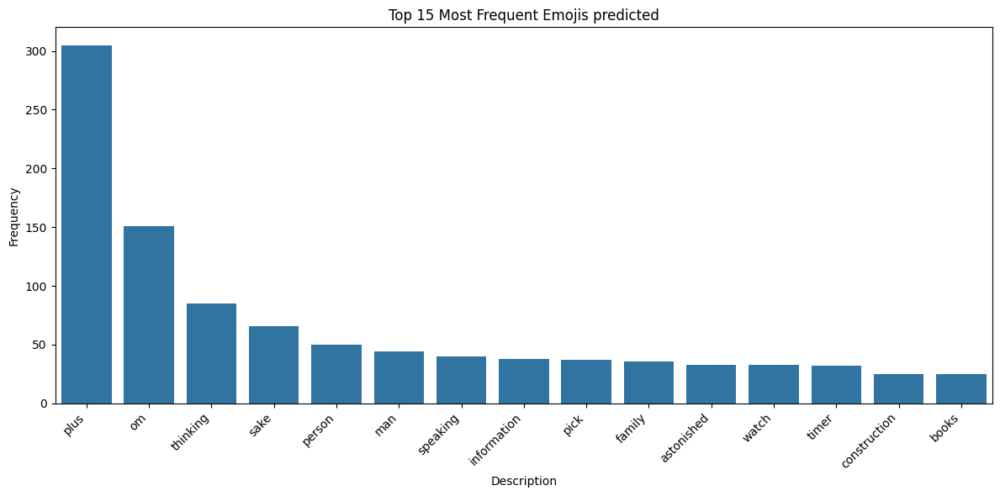

2025-05-17 10:50:46,922 - INFO - Creating keyword WordCloud...


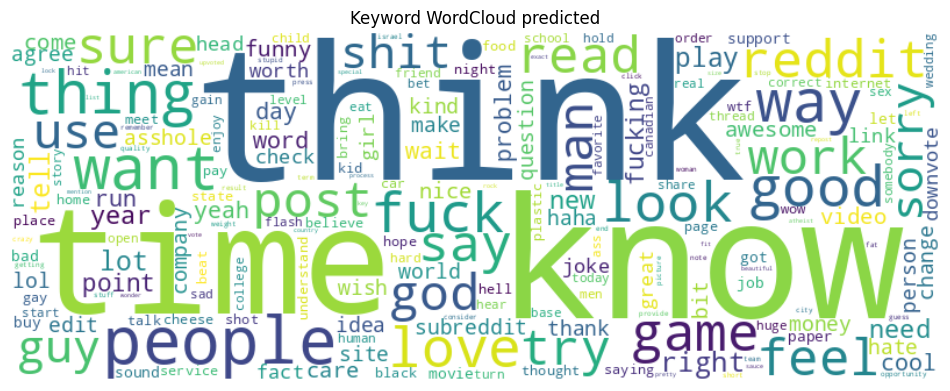

In [21]:
main(mode="predicted")

In [ ]:
main("predicted")